### **Contents**

0. Initial Setup
1. Business Problem Understanding
2. Data Understanding
3. Data Preprocessing
4. Modeling
5. Conclusion
6. Recommendation

****

### `Initial Setup`

In [453]:
# Import library eksplorasi dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

import pandas as pd
from geopy.geocoders import Nominatim

# Import library modeling


import warnings
warnings.filterwarnings('ignore')

### `Business Problem Understanding`

**Latar Belakang**

California adalah salah satu negara bagian yang paling berkembang dan terkenal di Amerika Serikat. Statusnya sebagai pusat teknologi, bisnis, dan hiburan menarik orang-orang untuk tinggal dan bekerja di wilayah ini. Karena itu, permintaan tinggi akan rumah di California menjadi salah satu faktor utama yang mendorong harga rumah menjadi tinggi. Pertumbuhan ekonomi yang berkelanjutan dan lapangan kerja yang kuat di wilayah ini membuat banyak orang mencari rumah, sehingga permintaan yang tinggi meningkatkan nilai properti.

Investasi di sektor real estat merupakan pilihan menarik bagi para investor untuk mencapai keuntungan jangka panjang. Salah satu sumber keuntungan utama bagi investor dalam real estat adalah peningkatan nilai properti dari waktu ke waktu. Potensi kenaikan nilai properti ini memberikan kesempatan bagi investor untuk memperoleh pengembalian investasi yang menguntungkan.

Dalam mempertimbangkan investasi di real estat, para investor perlu mengidentifikasi dan memahami potensi kenaikan nilai properti di masa depan dengan baik. Oleh karena itu, dilakukan prediksi harga rumah untuk mengestimasi seberapa besar kemungkinan nilai properti akan meningkat di waktu mendatang. Informasi prediksi ini sangat berharga bagi para investor dalam menentukan apakah investasi di properti tertentu akan memberikan pengembalian investasi yang menguntungkan atau tidak.

Dengan demikian, prediksi harga rumah memiliki peran penting dalam membantu para investor di sektor real estat untuk mengidentifikasi peluang investasi yang menjanjikan dan mencapai hasil yang menguntungkan dari investasi yang mereka lakukan.

**Problem Statement**

Bagaimana melakukan prediksi harga rumah di masa depan dengan akurat untuk membantu para investor dalam menilai potensi kenaikan nilai properti dan memastikan bahwa investasi yang direncanakan akan memberikan pengembalian investasi yang menguntungkan?

**Goals**

Mengembangkan model prediksi harga rumah yang akurat berdasarkan data historis dan faktor-faktor terkait seperti lokasi, karakteristik properti, dan kondisi ekonomi. Dengan prediksi harga rumah yang dapat diandalkan, para investor di sektor real estat akan dapat memahami lebih baik tentang potensi kenaikan nilai properti di masa depan dan membuat keputusan investasi yang lebih bijaksana.

**Analytic Approach**

Jadi yang akan kita lakukan adalah menganalisis data historis tentang harga rumah di California untuk menemukan pola-pola yang mempengaruhi kenaikan harga perumahan. Kemudian kita akan membangun model regresi yang dapat membantu dalam memprediksi harga perumahan di masa depan berdasarkan faktor-faktor yang relevan.

Model Regression memungkinkan kita untuk memodelkan hubungan antara variabel-variabel numerik seperti longitude, latitude, housing_median_age, total_rooms, total_bedrooms, population, households, dan median_income terhadap variabel target "median_house_value." Model regresi akan membantu dalam memahami bagaimana variabel-variabel ini berkontribusi terhadap harga rumah dan memberikan prediksi harga rumah yang akurat berdasarkan nilai-nilai variabel independen yang ada.

Dengan menggunakan metode Machine Learning Regression, para investor dapat memprediksi harga rumah di masa depan berdasarkan atribut-atribut properti yang relevan. Hal ini akan membantu mereka dalam menilai potensi kenaikan nilai properti dan membuat keputusan investasi yang lebih baik dan berdasarkan analisis data yang lebih informasional.

**Metric Evaluation**

Evaluasi metrik yang akan digunakan adalah MAE dan RMSE. Nilai MAE yang lebih rendah menunjukkan bahwa model memiliki kesalahan prediksi yang lebih kecil, sedangkan untuk RMSE semakin rendah nilai RMSE semakin baik performa model dalam memprediksi harga rumah.

Selain itu, kita juga bisa menggunakan nilai R-squared. Nilai R-squared yang mendekati 1 menunjukkan bahwa model berhasil menjelaskan variasi harga dengan baik (hanya digunakan saat model linier)

### `Data Understanding`

| Columns                                            | Definition                                                   | 
| ------------------------------------------------- | ------------------------------------------------------------ |
| longitude | A measure of how far west a house is; a more negative value is farther west |
| latitude | A measure of how far north a house is; a higher value is farther north |
| housing_median_age | Median age of a house within a block; a lower number is a newer building |
| total_rooms | Total number of rooms within a block |
| total_bedrooms | Total number of bedrooms within a block |
| population | Total number of people residing within a block |
| households | Total number of households, a group of people residing within a home unit, for a block |
| median_income | Median income for households within a block of houses (measured in tens of thousands of US Dollars) |
| median_house_value | 	Median house value for households within a block (measured in US Dollars) |
| ocean_proximity | Location of the house with respect to the ocean/sea |

Income\
1.7199 --> 1.7199 * 10,000 = 17,199

In [454]:
data = pd.read_csv("F:\Capstone-Project-3\Data\data_california_house.csv")
pd.set_option("display.max_columns", None)
display(data.head(), data.tail())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
14443,-121.26,38.27,20.0,1314.0,229.0,712.0,219.0,4.4125,INLAND,144600.0
14444,-120.89,37.48,27.0,1118.0,195.0,647.0,209.0,2.9135,INLAND,159400.0
14445,-121.90,36.58,31.0,1431.0,NaN,704.0,393.0,3.1977,NEAR OCEAN,289300.0
14446,-117.93,33.62,34.0,2125.0,498.0,1052.0,468.0,5.6315,<1H OCEAN,484600.0
14447,-115.56,32.80,15.0,1171.0,328.0,1024.0,298.0,1.3882,INLAND,69400.0


#### Menambah Kolom informasi county (Based on California County Boundaries Shapefile)

link website file : https://catalog.data.gov/dataset/tiger-line-shapefile-2019-state-california-current-county-subdivision-state-based 

Alasan:\
Kolom "County" akan memudahkan dalam melacak dan mengidentifikasi data berdasarkan wilayah administratif tertentu, yaitu county, yang dapat memiliki implikasi khusus dalam analisis data properti ini. Selain itu, informasi ini juga dapat membantu dalam mendeskripsikan blok atau kelompok data berdasarkan county tertentu, yang dapat memberikan wawasan lebih dalam tentang karakteristik dan pola di wilayah-wilayah tertentu di California.

In [455]:
import geopandas as gpd
from shapely.geometry import Point

# Ubah DataFrame menjadi GeoDataFrame
# 'Point' mengambil dua argumen: longitude dan latitude
gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.longitude, data.latitude), crs="EPSG:4326")

# data batas-batas county berdasarkan california county bounderies shapefile
counties = gpd.read_file("F:\Capstone-Project-3\Data\CA_Counties\CA_Counties_TIGER2016.shp")

# memastikan data lokasi dan data county memiliki CRS (Coordinate Reference System) yang sama
gdf = gdf.to_crs(counties.crs)

# Gabungkan data
joined = gpd.sjoin(gdf, counties, op='within')

# Ambil hanya kolom df dan kolom 'NAME' dan 'NAMELSAD'
columns_to_keep = data.columns.tolist() + ['NAMELSAD']
df = joined[columns_to_keep]

In [456]:
df = df.rename(columns={'NAMELSAD': 'County'})

In [457]:
print(f'Jumlah baris dan kolom: {df.shape}')

pd.DataFrame(
    {
    'feature': df.columns.values,
    'data_type': df.dtypes.values,
    'null_value': df.isna().mean().values * 100,
    'min': df.min().values,
    'max': df.max().values,
    'n_unique': df.nunique().values,
    'sample_unique': [df[col].unique() for col in df.columns]
    }
)

Jumlah baris dan kolom: (14446, 11)


,feature,data_type,null_value,min,max,n_unique,sample_unique
0,longitude,float64,0.000000,-124.35,-114.31,806,"[-119.79, -119.81, -120.38, -119.83, -119.82, ..."
1,latitude,float64,0.000000,32.55,41.95,835,"[36.73, 36.76, 36.8, 36.71, 36.81, 36.75, 36.6..."
2,housing_median_age,float64,0.000000,1.0,52.0,52,"[52.0, 50.0, 12.0, 24.0, 25.0, 39.0, 33.0, 19...."
3,total_rooms,float64,0.000000,2.0,32627.0,5227,"[112.0, 772.0, 932.0, 3756.0, 1026.0, 3305.0, ..."
4,total_bedrooms,float64,0.948359,1.0,6445.0,1748,"[28.0, 194.0, 244.0, 681.0, 221.0, 551.0, 563...."
5,population,float64,0.000000,3.0,35682.0,3498,"[193.0, 606.0, 1043.0, 1586.0, 789.0, 1149.0, ..."
6,households,float64,0.000000,1.0,6082.0,1649,"[40.0, 167.0, 243.0, 739.0, 183.0, 500.0, 491...."
7,median_income,float64,0.000000,0.4999,15.0001,9796,"[1.975, 2.2206, 1.4038, 3.8571, 1.5625, 5.0698..."
8,ocean_proximity,object,0.000000,<1H OCEAN,NEAR OCEAN,5,"[INLAND, NEAR BAY, <1H OCEAN, NEAR OCEAN, ISLAND]"
9,median_house_value,float64,0.000000,14999.0,500001.0,3548,"[47500.0, 59200.0, 54300.0, 90100.0, 52800.0, ..."


Fixing Values

- Converting Data Type

In [459]:
# Tentukan kolom-kolom yang ingin diubah tipe datanya
Variabel = ['housing_median_age' , 'total_rooms', 'population', 'households']

# mengubah tipe data menjadi int
df[Variabel] = df[Variabel].astype(int)

In [460]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14446 entries, 0 to 14355
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           14446 non-null  float64
 1   latitude            14446 non-null  float64
 2   housing_median_age  14446 non-null  float64
 3   total_rooms         14446 non-null  int32  
 4   total_bedrooms      14309 non-null  float64
 5   population          14446 non-null  int32  
 6   households          14446 non-null  int32  
 7   median_income       14446 non-null  float64
 8   ocean_proximity     14446 non-null  object 
 9   median_house_value  14446 non-null  float64
 10  County              14446 non-null  object 
dtypes: float64(6), int32(3), object(2)
memory usage: 1.2+ MB


__Insight :__
* Dataset Asli terdiri dari 10 kolom dan 14448 baris, tetapi setelah ditambahkan kolom baru menjadi 11 kolom.
* Variabel numerik: longitude, latitude, housing_median_age, total_rooms, total_bedrooms, population, households, median_income, median_house_value
* Variabel categorical: ocean_proximity dan County
* Tipe data sudah disesuaikan, terdapat perubahan tipe data yaitu pada kolom total_rooms, population dan household
* Terdapat missing value pada fitur total_bedrooms sebesar 0.9%
* Fitur "median_house_value" adalah target variabel atau variabel yang ingin diprediksi. Nilai median house value berkisar dari 14,999 hingga 500,001, dan ada sejumlah 3548 nilai unik. Ini menunjukkan bahwa ada variasi besar dalam harga rumah di dataset.

#### **Numerical variable**

In [578]:
# Statistik deskriptif (data numerik)
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,avg_rooms_per_house,avg_bedrooms_per_house,avg_persons_per_house,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD
count,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000,12552.000000
mean,-119.589869,35.684673,29.284895,2171.298757,451.064691,1233.482393,422.450526,3.597446,0.798757,186369.375159,5.305768,1.040711,3.102215,275.113584,384.189649,401.578306,347.965606,403.669202
std,2.003732,2.167831,12.189267,1112.629044,227.435141,676.671497,211.712196,1.508542,0.792044,92077.299713,2.252496,0.458300,7.358458,249.845331,248.516039,248.299097,216.359967,292.141414
min,-124.350000,32.550000,1.000000,2.000000,2.000000,3.000000,2.000000,0.499900,0.000000,14999.000000,1.000000,0.000000,1.000000,0.921305,0.000000,0.000000,0.000000,0.000000
25%,-121.770000,33.940000,19.000000,1384.750000,287.000000,772.000000,271.750000,2.492200,0.000000,113575.000000,4.000000,1.000000,2.000000,32.498433,120.338960,129.378233,117.491308,158.968492
50%,-118.560000,34.290000,30.000000,1998.000000,415.000000,1126.000000,391.000000,3.388900,1.000000,170200.000000,5.000000,1.000000,3.000000,179.864725,513.555122,538.471721,451.183339,230.450461
75%,-118.010000,37.740000,37.000000,2822.000000,588.000000,1587.000000,549.000000,4.486450,1.000000,241000.000000,6.000000,1.000000,3.000000,530.041276,583.024376,604.315880,516.562142,708.298206
max,-114.550000,41.950000,52.000000,5694.000000,1175.000000,8733.000000,1537.000000,15.000100,2.000000,452300.000000,133.000000,34.000000,600.000000,1018.198911,902.562388,897.153237,836.830705,1196.553576


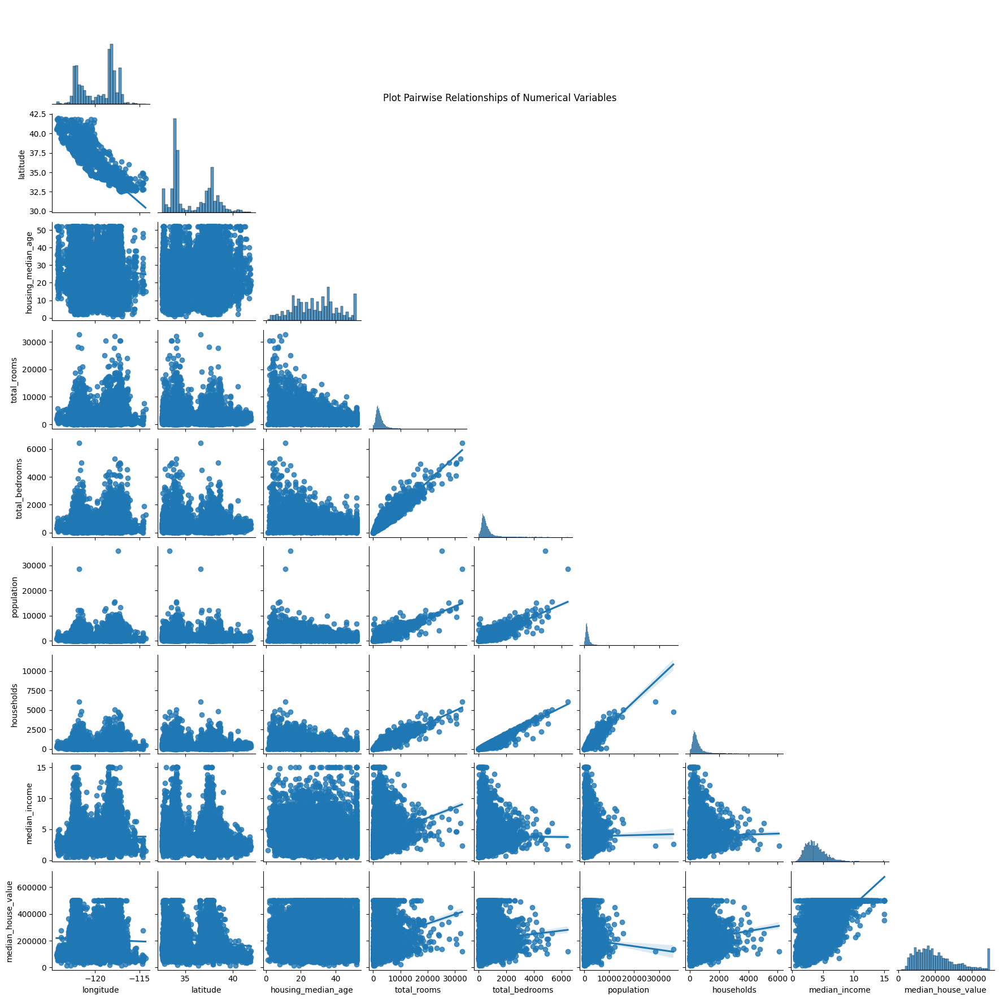

In [462]:
numerical = [var for var in df.columns if df[var].dtype != 'object']

graph = sns.pairplot(df[numerical], height=2.0, corner=True, kind='reg')
graph.fig.suptitle("Plot Pairwise Relationships of Numerical Variables", y=0.9)
plt.show()

__Insight :__
* Distribusi data pada variabel di dataset ini tergolong tidak normal
* Variabel numeric pada dataset ini termasuk variabel continue
* Pada fitur median_house_value memilki beberapa outliers
* "total_rooms" dan "total_bedrooms", serta "population" dan "households" menunjukkan korelasi linear positif. sedangkan, "housing_median_age" dan "median_house_value" menunjukkan korelasi linear negatif.


nb:
distribusi
rentang skala
pola data, apakah ada hub linieritas antar var
outlier
hubungan antar var

In [463]:
numerik_df = df.select_dtypes(include=[np.number])  # hanya kolom numerik
corr = numerik_df.corr(method='pearson')
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.925208,-0.117381,0.057354,0.079579,0.108177,0.064264,-0.009990,-0.045676
latitude,-0.925208,1.000000,0.020738,-0.048542,-0.076828,-0.117656,-0.080049,-0.085205,-0.144112
housing_median_age,-0.117381,0.020738,1.000000,-0.368041,-0.329577,-0.299843,-0.312536,-0.120645,0.103739
total_rooms,0.057354,-0.048542,-0.368041,1.000000,0.931992,0.853466,0.919289,0.199458,0.131919
total_bedrooms,0.079579,-0.076828,-0.329577,0.931992,1.000000,0.874625,0.978563,-0.004246,0.045871
population,0.108177,-0.117656,-0.299843,0.853466,0.874625,1.000000,0.905062,0.006195,-0.026199
households,0.064264,-0.080049,-0.312536,0.919289,0.978563,0.905062,1.000000,0.016259,0.061541
median_income,-0.009990,-0.085205,-0.120645,0.199458,-0.004246,0.006195,0.016259,1.000000,0.693278
median_house_value,-0.045676,-0.144112,0.103739,0.131919,0.045871,-0.026199,0.061541,0.693278,1.000000


- Variabel Median Income memiliki korelasi positif yang cukup kuat dengan Median House Value (sekitar 0.69). Hal ini menunjukkan bahwa semakin tinggi median income suatu wilayah, kemungkinan besar harga rumah median di wilayah tersebut juga cenderung lebih tinggi.
- Variabel housing_median_age memiliki korelasi negatif yang rendah dengan Median House Value, menunjukkan bahwa hubungan usia hunian dengan harga rumah median tidak terlalu kuat.
- Variabel median_income memiliki korelasi negatif yang rendah dengan beberapa variabel lain seperti housing_median_age, population, dan households.
- Total_bedrooms memiliki hubungan kuat dengan total_rooms (nilai korelasi sekitar 0.932) dan households (nilai korelasi sekitar 0.979). Hubungan ini menunjukkan bahwa semakin banyak total kamar tidur di suatu wilayah, kemungkinan besar juga akan terdapat lebih banyak total kamar dan lebih banyak jumlah rumah tangga di wilayah tersebut.


#### **Categorical variable**

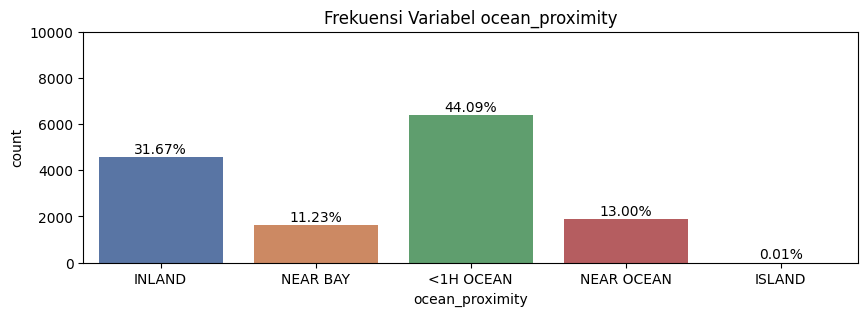

In [464]:
plt.subplots(figsize=(10, 3))
plt.title("Frekuensi Variabel ocean_proximity")
ax = sns.countplot(data=df, x="ocean_proximity", palette='deep')
ax.set_ylim([0, 10000])

for p in ax.patches:
    percentage = f'{100 * p.get_height() / len(df):.2f}%\n'
    x = p.get_x() + p.get_width() / 2
    y = p.get_height()
    ax.annotate(percentage, (x, y), ha='center', va='center')

plt.show()

In [465]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    1878
NEAR BAY      1622
ISLAND           2
Name: ocean_proximity, dtype: int64

__Insight :__
* Grafik menunjukkan distribusi frekuensi dari setiap kategori pada fitur "ocean_proximity". Kategori dengan nilai terbanyak adalah "<1H OCEAN" diikuti oleh "INLAND", "NEAR OCEAN", "NEAR BAY", dan "ISLAND".
* Kategori "<1H OCEAN" memiliki frekuensi tertinggi dan mendominasi distribusi dengan persentase 44.08%. Ini menunjukkan bahwa sebagian besar rumah dalam dataset ini berlokasi di daerah yang dekat dengan laut (<1 jam perjalanan).
* Kategori "ISLAND" memiliki frekuensi terendah dengan persentase sekitar 0.10%. Ini menunjukkan bahwa hanya sedikit rumah yang berlokasi di pulau (island).

In [466]:
import folium
from sklearn.preprocessing import MinMaxScaler
import matplotlib.colors as mcolors

# Min-Max Scaling pada kolom "population"
scaler = MinMaxScaler()
df['scaled_population'] = scaler.fit_transform(df[['population']])

# Buat peta folium dengan koordinat tengah California
map_california = folium.Map(location=[36.7783, -119.4179], zoom_start=6)

# Buat linear gradient untuk warna berdasarkan rentang nilai dari median_house_value
vmin = df['median_house_value'].min()
vmax = df['median_house_value'].quantile(0.95)
colormap = mcolors.LinearSegmentedColormap.from_list("", ["blue", "red"])

# scatter plot pada peta dengan ukuran circle yang disesuaikan dengan skala populasi
for index, row in df.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=row['scaled_population']*20,
                        popup=f"Median House Value: ${row['median_house_value']}",
                        fill_color=colormap((row['median_house_value'] - vmin) / (vmax - vmin)),
                        fill=True, fill_opacity=0.7).add_to(map_california)

# Tampilkan peta
map_california

# ''' iterasi akan menghasilkan baris baru yang ditentukan oleh index dan berisi semua nilai pada baris tersebut dalam objek row.
# Dengan menggunakan row, kita dapat dengan mudah mengakses nilai dari setiap kolom pada baris yang bersangkutan.'''


In [467]:
# Hapus kolom 'scaled_population' dari DataFrame df
df.drop('scaled_population', axis=1, inplace=True)

__Insight :__
* Persebaran rumah di california paling banyak di kota kota besar di california seperti Los Angeles, San Francisco, San Jose, Sacramento, dan San Diego. Sedangkan, untuk di wilayah selain di kota kota besar tergolong tersebar tidak berpusat pada suatu wilayah.
* Populasi masyarkat yang memilki rumah, terbesar terdapat pada county San Diego dan populasi dengan jumlah yang tergolong besar juga hanya terdapat pada kota kota besar.

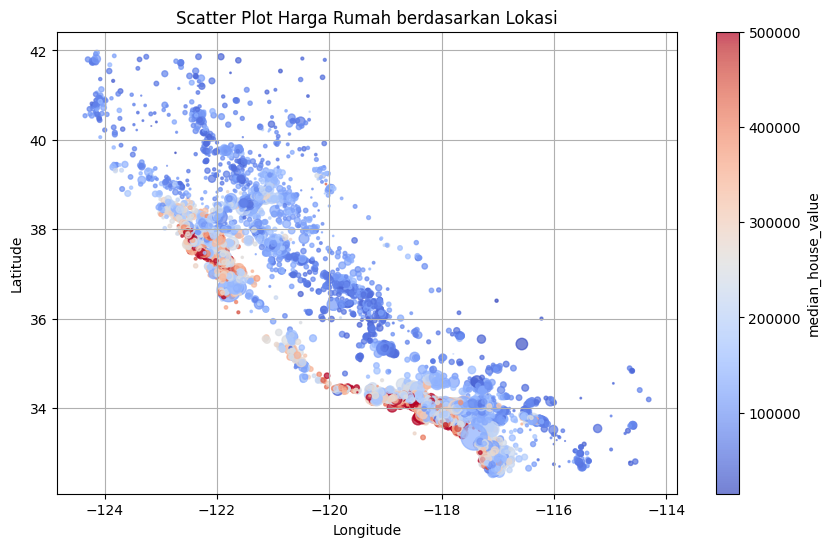

In [468]:
plt.figure(figsize=(10, 6))  # Atur ukuran gambar
plt.scatter(df.longitude, df.latitude, c=df.median_house_value, cmap='coolwarm', s=df.population/100, alpha=0.7)

#label sumbu dan judul
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot Harga Rumah berdasarkan Lokasi')

#colorbar untuk menggambarkan skala harga rumah
colorbar = plt.colorbar()
colorbar.set_label('median_house_value')

plt.grid(True)  # Tampilkan grid
plt.show()      # Tampilkan plot

__Insight :__
* rumah dengan harga yang tergolong tinggi terdapat pada poin yang berwarna merah yaitu di disekitar kota San Fransisco dan Los Angels dan untuk lokasinya berada di daerah pinggir pantai (Near Ocean).

In [469]:
df_OceanProximity = df.copy()

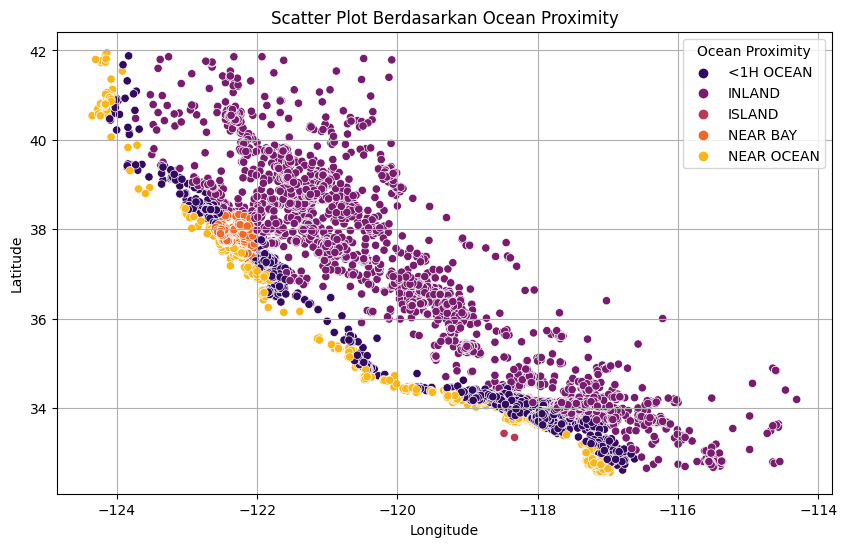

In [470]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df_OceanProximity is a DataFrame containing the unique categories of 'ocean_proximity'
df_OceanProximity['ocean_proximity'] = df_OceanProximity['ocean_proximity'].astype('category')

plt.figure(figsize=(10, 6))  # Atur ukuran gambar
sns.scatterplot(data=df_OceanProximity, x='longitude', y='latitude', hue='ocean_proximity',
                palette='inferno')

# Label sumbu dan judul
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot Berdasarkan Ocean Proximity')

# Tampilkan legend
plt.legend(title='Ocean Proximity')

plt.grid(True)  
plt.show() 


In [471]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    1878
NEAR BAY      1622
ISLAND           2
Name: ocean_proximity, dtype: int64

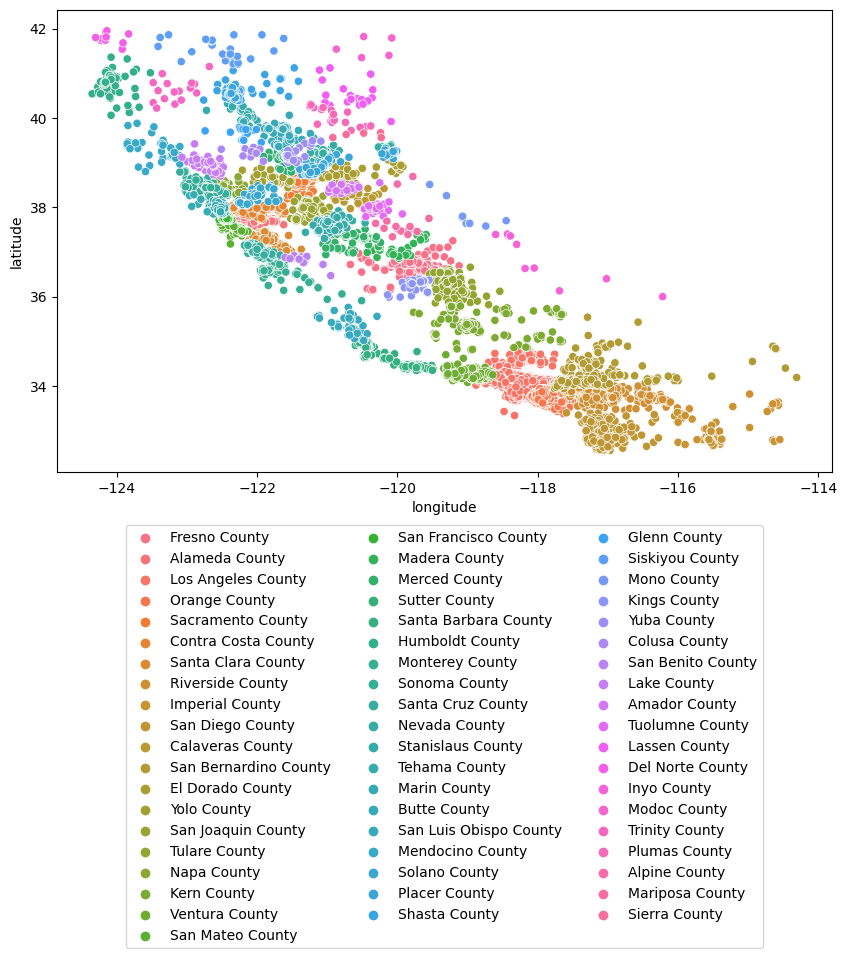

In [472]:
# Set the color palette to 'tab20'
sns.set_palette('tab20')

plt.figure(figsize=(10, 6))
sns.scatterplot(x='longitude', y='latitude', hue='County', data=df)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=3)
plt.show()


In [473]:
df.County.value_counts()

Los Angeles County        4037
Orange County             1153
San Diego County          1144
Alameda County             729
Santa Clara County         696
San Bernardino County      587
Sacramento County          470
Contra Costa County        418
Riverside County           414
San Francisco County       389
Fresno County              352
San Mateo County           318
San Joaquin County         293
Ventura County             279
Kern County                272
Sonoma County              219
Stanislaus County          214
Santa Barbara County       206
Tulare County              186
Monterey County            144
Solano County              131
Santa Cruz County          130
Marin County               120
Butte County               111
Placer County              103
Merced County               97
San Luis Obispo County      95
Humboldt County             95
Shasta County               87
Imperial County             82
El Dorado County            81
Napa County                 75
Nevada C

County yang memilki jumlah rumah terbanyak yaitu pada Los Angeles County

In [474]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.median_house_value)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


In [475]:
median_values = df.groupby('County')['median_house_value'].median()
median_values.sort_values(ascending=False)

County
Marin County              347650.0
San Mateo County          339550.0
San Francisco County      333300.0
Santa Clara County        275800.0
Santa Barbara County      249650.0
Santa Cruz County         238150.0
Ventura County            234300.0
Orange County             230700.0
San Benito County         219400.0
San Luis Obispo County    208200.0
Monterey County           208150.0
Los Angeles County        203800.0
Alameda County            193500.0
Sonoma County             193300.0
Contra Costa County       186950.0
Napa County               185700.0
San Diego County          169000.0
Placer County             158600.0
Nevada County             154900.0
Mono County               148400.0
Yolo County               135450.0
Solano County             133100.0
Alpine County             129100.0
El Dorado County          127300.0
Riverside County          125100.0
Stanislaus County         122800.0
Amador County             120900.0
Sacramento County         119150.0
Tuolumne Coun

County yang memilki harga termahal yaitu pada Marin County, sedangkan Marin COunty dekat dengan Kota San Francisco

In [476]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.population)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


In [477]:
median_population = df.groupby('County')['population'].median()
median_population.sort_values(ascending=False)

County
Riverside County          1546.0
Ventura County            1482.0
San Benito County         1458.5
Yolo County               1452.0
San Luis Obispo County    1380.0
San Bernardino County     1356.0
Del Norte County          1320.5
Merced County             1283.0
Orange County             1255.0
Santa Clara County        1240.5
Monterey County           1239.5
Los Angeles County        1226.0
San Diego County          1226.0
Kern County               1216.5
Tulare County             1200.5
Fresno County             1142.0
San Francisco County      1136.0
Siskiyou County           1136.0
Sacramento County         1132.0
San Mateo County          1131.5
Contra Costa County       1129.0
Solano County             1113.0
Santa Barbara County      1092.5
Santa Cruz County         1080.0
Inyo County               1076.5
Sonoma County             1073.0
Sutter County             1038.5
Shasta County             1011.0
Madera County             1004.5
Tehama County             1003.0
San

In [478]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.households)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


In [479]:
median_population = df.groupby('County')['households'].median()
median_population.sort_values(ascending=False)

County
San Luis Obispo County    548.0
Yolo County               547.0
Riverside County          506.0
Del Norte County          496.5
Ventura County            496.0
San Diego County          466.5
San Bernardino County     463.0
Sacramento County         443.0
Santa Clara County        443.0
San Francisco County      442.0
Siskiyou County           437.5
Orange County             436.0
Sonoma County             434.0
Monterey County           433.0
Solano County             426.0
Marin County              424.5
Contra Costa County       417.5
Inyo County               412.0
Kern County               410.0
San Benito County         409.0
San Mateo County          408.0
Los Angeles County        407.0
Shasta County             399.0
Napa County               398.0
Madera County             397.0
Santa Barbara County      388.0
Merced County             378.0
Santa Cruz County         378.0
Fresno County             376.5
Calaveras County          373.5
Sutter County             368.5
T

### `Data Preparation`

In [480]:
df = df.copy()
df.sample(5)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,County
4232,-118.42,34.16,28.0,4664,1040.0,1963,961,3.9028,<1H OCEAN,367900.0,Los Angeles County
10390,-118.07,34.00,42.0,1392,351.0,1471,348,2.6300,<1H OCEAN,143800.0,Los Angeles County
659,-118.07,34.11,47.0,832,194.0,419,156,3.1576,<1H OCEAN,225000.0,Los Angeles County
4270,-118.37,33.87,19.0,757,148.0,361,141,6.0200,<1H OCEAN,304200.0,Los Angeles County
10420,-118.19,34.67,8.0,11275,1822.0,5731,1692,5.0285,INLAND,167900.0,Los Angeles County


__Insight :__
* Grafik menunjukkan distribusi frekuensi dari setiap kategori pada fitur "ocean_proximity". Kategori dengan nilai terbanyak adalah "<1H OCEAN" diikuti oleh "INLAND", "NEAR OCEAN", "NEAR BAY", dan "ISLAND".
* Kategori "<1H OCEAN" memiliki frekuensi tertinggi dan mendominasi distribusi dengan persentase 44.08%. Ini menunjukkan bahwa sebagian besar rumah dalam dataset ini berlokasi di daerah yang dekat dengan laut (<1 jam perjalanan).
* Kategori "ISLAND" memiliki frekuensi terendah dengan persentase sekitar 0.10%. Ini menunjukkan bahwa hanya sedikit rumah yang berlokasi di pulau (island).

#### **Data Wrangling**

**Duplicat Data**, Tidak ditemukan duplicate data pada dataset ini

In [481]:
# Cek data duplikat
df.duplicated().sum()

0

**Missing Value**, ditemukan pada variabel `total_bedrooms` yaitu sebesar 0.9%. Selain itu, juga diketahui bahwa pada dataset ini tidak memilki duplicated data

Deteksi dan kuantifikasi missing value:

In [482]:
print(f'Jumlah baris dan kolom: {df.shape}')

pd.DataFrame(
    {
    'feature': df.columns.values,
    'data_type': df.dtypes.values,
    'null_value': df.isna().mean().values * 100,
    'min': df.min().values,
    'max': df.max().values,
    'n_unique': df.nunique().values,
    'sample_unique': [df[col].unique() for col in df.columns]
    }
)

Jumlah baris dan kolom: (14446, 11)


,feature,data_type,null_value,min,max,n_unique,sample_unique
0,longitude,float64,0.000000,-124.35,-114.31,806,"[-119.79, -119.81, -120.38, -119.83, -119.82, ..."
1,latitude,float64,0.000000,32.55,41.95,835,"[36.73, 36.76, 36.8, 36.71, 36.81, 36.75, 36.6..."
2,housing_median_age,float64,0.000000,1.0,52.0,52,"[52.0, 50.0, 12.0, 24.0, 25.0, 39.0, 33.0, 19...."
3,total_rooms,int32,0.000000,2,32627,5227,"[112, 772, 932, 3756, 1026, 3305, 2233, 1036, ..."
4,total_bedrooms,float64,0.948359,1.0,6445.0,1748,"[28.0, 194.0, 244.0, 681.0, 221.0, 551.0, 563...."
5,population,int32,0.000000,3,35682,3498,"[193, 606, 1043, 1586, 789, 1149, 2031, 620, 1..."
6,households,int32,0.000000,1,6082,1649,"[40, 167, 243, 739, 183, 500, 491, 174, 518, 4..."
7,median_income,float64,0.000000,0.4999,15.0001,9796,"[1.975, 2.2206, 1.4038, 3.8571, 1.5625, 5.0698..."
8,ocean_proximity,object,0.000000,<1H OCEAN,NEAR OCEAN,5,"[INLAND, NEAR BAY, <1H OCEAN, NEAR OCEAN, ISLAND]"
9,median_house_value,float64,0.000000,14999.0,500001.0,3548,"[47500.0, 59200.0, 54300.0, 90100.0, 52800.0, ..."


<Axes: >

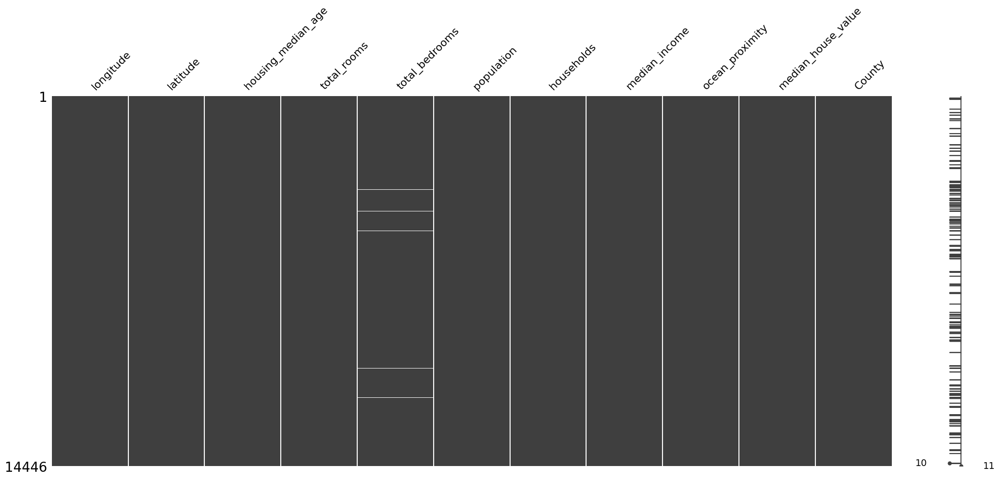

In [483]:
msno.matrix(df)

__Insight :__ 
* Missing value pada fitur total_bedrooms sebesar 0.9% atau 137 row data.
* Pada data ini pola missing value antar tabel `tidak saling berkaitan` karena letak missing value hanya pada kolom `total_bedrooms`

Handling missing value:

In [484]:
df_OceanProximity.dropna(inplace=True)

In [485]:
len(df_OceanProximity)

14309

In [486]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df_OceanProximity.total_bedrooms)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


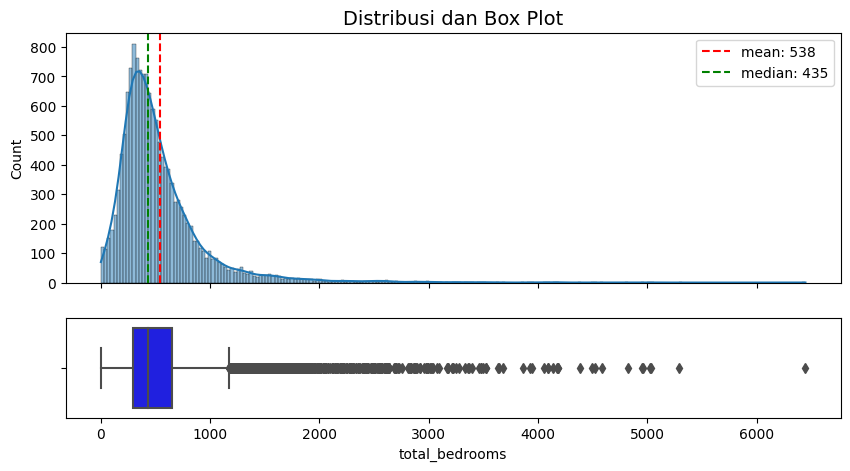

In [487]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df_OceanProximity.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df_OceanProximity.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df_OceanProximity['total_bedrooms'].mean(), color='red', label=f"mean: {round(df_OceanProximity['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df_OceanProximity['total_bedrooms'].median(), color='green', label=f"median: {round(df_OceanProximity['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [488]:
selected_columns = ['total_bedrooms', 'total_rooms', 'population', 'households', 'median_income', 'median_house_value']
correlation_matrix = df[selected_columns].corr()
correlation_matrix


,total_bedrooms,total_rooms,population,households,median_income,median_house_value
total_bedrooms,1.000000,0.931992,0.874625,0.978563,-0.004246,0.045871
total_rooms,0.931992,1.000000,0.853466,0.919289,0.199458,0.131919
population,0.874625,0.853466,1.000000,0.905062,0.006195,-0.026199
households,0.978563,0.919289,0.905062,1.000000,0.016259,0.061541
median_income,-0.004246,0.199458,0.006195,0.016259,1.000000,0.693278
median_house_value,0.045871,0.131919,-0.026199,0.061541,0.693278,1.000000


In [489]:
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,14446.000000,14446.000000,14446.000000,14446.000000,14309.000000,14446.000000,14446.000000,14446.000000,14446.000000
mean,-119.566796,35.630077,28.620795,2640.332826,538.288210,1425.240136,499.540911,3.867008,206833.876159
std,2.006613,2.139935,12.596078,2191.696060,423.600432,1149.630385,383.115233,1.891067,115367.628513
min,-124.350000,32.550000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1451.000000,295.000000,784.000000,279.000000,2.571400,119625.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1165.000000,410.000000,3.539100,180000.000000
75%,-118.000000,37.710000,37.000000,3148.000000,647.000000,1724.000000,604.000000,4.736100,263900.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [490]:
# total_bedrooms yang kosong
missing_bedrooms_data = df[df['total_bedrooms'].isnull()]

# data beserta nilai pada kolom households dan total_rooms
missing_bedrooms_data[['total_bedrooms', 'households', 'total_rooms']]


,total_bedrooms,households,total_rooms
3209,NaN,224,1098
3886,NaN,928,5016
4288,NaN,1260,6403
4972,NaN,243,1302
3203,NaN,259,992
...,...,...,...
13053,NaN,600,3759
10608,NaN,738,5129
13628,NaN,516,2811
410,NaN,181,994


In [491]:
# nilai median total_bedrooms berdasarkan households
median_bedrooms = df.groupby(['households'])['total_bedrooms'].median()

# Input missing value pada total_bedrooms berdasarkan households
def fill_missing_bedrooms(row):
    if pd.isnull(row['total_bedrooms']):
        median_value = median_bedrooms.get(row['households'])  
        return median_value
    else:
        return row['total_bedrooms']

# Input missing value pada total_bedrooms
df['total_bedrooms'] = df.apply(fill_missing_bedrooms, axis=1)

# Input nilai NaN dengan mean sebelum melakukan pembulatan
df['total_bedrooms'].fillna(df['total_bedrooms'].median(), inplace=True)

# Melakukan pembulatan
df['total_bedrooms'] = df['total_bedrooms'].round().astype(int)


In [492]:
# Merubah tipe data total_bedrooms menjadi int
df['total_bedrooms'] = df['total_bedrooms'].astype(int)

__Insight :__ 
* Missing value pada fitur total_bedrooms diinput dengan mean (rata-rata) total_bedrooms yang didasarkan pada households yang sama. Karena total_bedrooms termasuk kedalam distribusi normal (setelah dilakukan uji statistik distribusi) dan total_bedrooms memilki korelasi kuat dengan variabel household.
* Pada value yang dilakukan penginputan dengan pembulatan karena total_bedrooms tidak memungkinkan dengan value desimal.

`!!! KALAU JD PAKAI PIPELINE`

In [493]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, RobustScaler


**Rare label**, ditemukan pada variabel `ocean_proximity`, terdapat 1 kategori yang jarang mucul atau dibawah batas ambang yaitu pada kategori ISLAND. sedangkan untuk kategori lainnya sudah tergolong dominan. karena jika rare label digunakan dapat menambah noise, menyebabkan over-fitting pada model.

Deteksi dan kuantifikasi rare value:

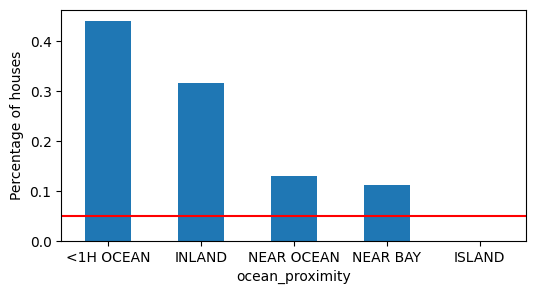

In [494]:
temp_df = pd.Series(df['ocean_proximity'].value_counts() / len(df))

plt.figure(figsize=(6, 3))
fig = temp_df.sort_values(ascending=False).plot.bar(rot=0)
fig.set_xlabel('ocean_proximity')

fig.axhline(y=0.05, color='red')
fig.set_ylabel('Percentage of houses')
plt.show()

In [495]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    1878
NEAR BAY      1622
ISLAND           2
Name: ocean_proximity, dtype: int64

Kelompokkan ulang variabel kategorikal `ocean_proximity` menjadi 3 kategori yaitu <1H Ocean, NEAR OCEAN dan NEAR BAY

In [496]:
df_filter = df[df.ocean_proximity == 'NEAR OCEAN']
df_filter.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000,1878.000000
mean,-119.338765,34.758040,29.362620,2623.264111,541.379659,1365.956869,505.648030,4.015629,249872.442492
std,2.343943,2.305262,11.890059,2063.996560,382.271113,1025.847548,353.609435,1.976171,123052.043976
min,-124.350000,32.550000,2.000000,15.000000,3.000000,8.000000,3.000000,0.643300,37500.000000
25%,-122.030000,32.780000,20.000000,1505.750000,311.000000,784.000000,296.250000,2.634250,150075.000000
50%,-118.245000,33.790000,29.000000,2197.000000,465.500000,1135.500000,433.000000,3.682700,228750.000000
75%,-117.180000,36.990000,37.000000,3148.250000,667.750000,1620.750000,616.500000,4.903300,325975.000000
max,-116.970000,41.950000,52.000000,30405.000000,4585.000000,12873.000000,4176.000000,15.000100,500001.000000


In [497]:
df_filter1 = df[df.ocean_proximity == 'NEAR BAY']
df_filter1.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000,1622.000000
mean,-122.259679,37.803181,37.655980,2452.847719,506.860666,1208.284217,479.975339,4.179790,258512.974723
std,0.146658,0.185480,13.161926,1769.438069,361.020880,847.402585,337.545445,2.034724,123794.049463
min,-122.590000,37.350000,2.000000,8.000000,1.000000,8.000000,1.000000,0.499900,22500.000000
25%,-122.400000,37.730000,28.250000,1416.250000,284.000000,709.500000,272.000000,2.823625,162500.000000
50%,-122.250000,37.790000,39.000000,2079.500000,419.000000,1029.000000,401.500000,3.819200,230800.000000
75%,-122.140000,37.910000,52.000000,3011.250000,623.000000,1481.000000,590.000000,5.045850,347475.000000
max,-122.010000,38.340000,52.000000,18634.000000,3226.000000,8117.000000,3052.000000,15.000100,500001.000000


In [498]:
df_filter2 = df[df.ocean_proximity == 'ISLAND']
df_filter2.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,2.000000,2.00000,2.000000,2.000000,2.000000,2.000000,2.00000,2.000000,2.000000
mean,-118.405000,33.38500,40.500000,1537.500000,402.500000,761.000000,302.00000,2.718750,351100.000000
std,0.106066,0.06364,16.263456,1161.776441,266.579257,479.418398,182.43355,0.161998,89943.982567
min,-118.480000,33.34000,29.000000,716.000000,214.000000,422.000000,173.00000,2.604200,287500.000000
25%,-118.442500,33.36250,34.750000,1126.750000,308.250000,591.500000,237.50000,2.661475,319300.000000
50%,-118.405000,33.38500,40.500000,1537.500000,402.500000,761.000000,302.00000,2.718750,351100.000000
75%,-118.367500,33.40750,46.250000,1948.250000,496.750000,930.500000,366.50000,2.776025,382900.000000
max,-118.330000,33.43000,52.000000,2359.000000,591.000000,1100.000000,431.00000,2.833300,414700.000000


__Insight :__ 
* Rata rata median_house_value untuk data yang termasuk ocean_proximity di **NEAR OCEAN**, **NEAR BAY**, dan **ISLAND** hampir sama maka dapat dijadikan 1 menjadi 1 kategori yaitu **NEAR OCEAN**. 
* **NEAR OCEAN**, **NEAR BAY**, dan **ISLAND** dapat dijadikan satu karena mereka sama sama masih terletak disekitar laut / pantai.


Alasan:\
karena island jumlah hanya 2 dan jika di cek berdasarkan mean/median (tergantung jenis distribusi) tidak dapat di group berdasarkan kategori yang lain karena memilki value mean/median yang jauh maka solusi dilakukan drop. --> Distribusi Tidak Normal (gunakan median)

Handling rare value:

In [499]:
df = df[df['ocean_proximity'] != 'ISLAND']

In [500]:
def group_ocean_proximity(x):
    if x == 'NEAR OCEAN' or x == 'NEAR BAY':
        return 'NEAR OCEAN'
    elif x == '<1H OCEAN':
        return '<1H OCEAN'
    else:
        return 'INLAND'
    
df['ocean_proximity'] = df['ocean_proximity'].apply(lambda x: group_ocean_proximity(x))

In [501]:
df.ocean_proximity.value_counts()

<1H OCEAN     6369
INLAND        4575
NEAR OCEAN    3500
Name: ocean_proximity, dtype: int64

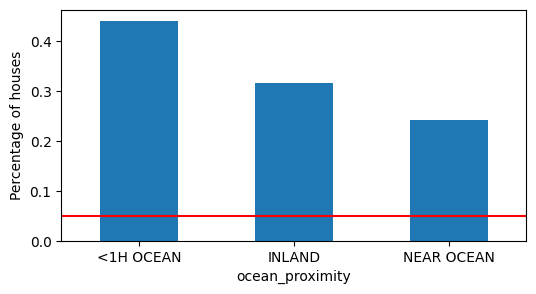

In [502]:
temp_df = pd.Series(df['ocean_proximity'].value_counts() / len(df))

plt.figure(figsize=(6, 3))
fig = temp_df.sort_values(ascending=False).plot.bar(rot=0)
fig.set_xlabel('ocean_proximity')

fig.axhline(y=0.05, color='red')
fig.set_ylabel('Percentage of houses')
plt.show()

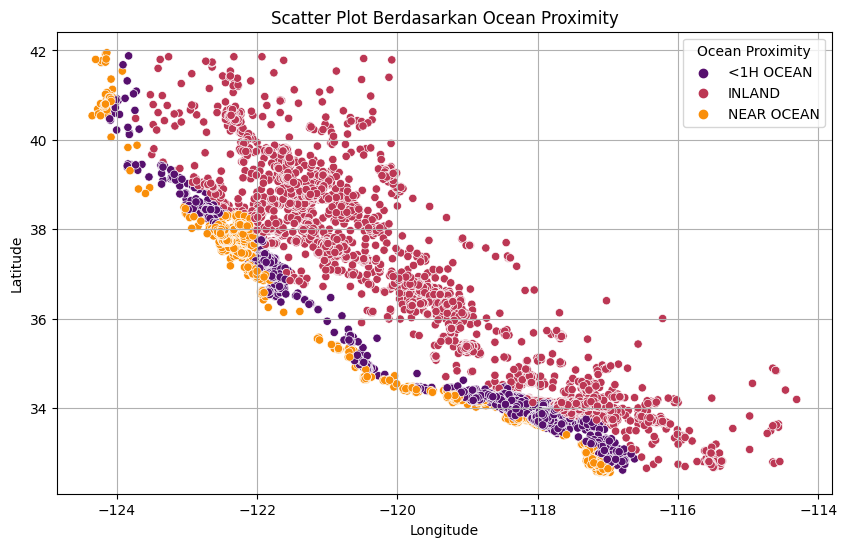

In [503]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df_OceanProximity is a DataFrame containing the unique categories of 'ocean_proximity'
df['ocean_proximity'] = df['ocean_proximity'].astype('category')

plt.figure(figsize=(10, 6))  # Atur ukuran gambar
sns.scatterplot(data=df, x='longitude', y='latitude', hue='ocean_proximity',
                palette='inferno')

# Label sumbu dan judul
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot Berdasarkan Ocean Proximity')

# Tampilkan legend
plt.legend(title='Ocean Proximity')

plt.grid(True)  
plt.show() 


In [504]:
df_NearOcean = df[df.ocean_proximity == 'NEAR OCEAN']
df_NearOcean.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,3500.000000,3500.000000,3500.00000,3500.000000,3500.000000,3500.000000,3500.000000,3500.000000,3500.000000
mean,-120.692400,36.169246,33.20600,2544.288286,525.382571,1292.886857,493.750571,4.091706,253876.712000
std,2.253737,2.274462,13.16063,1934.675975,372.918664,950.466283,346.445126,2.004904,123454.049088
min,-124.350000,32.550000,2.00000,8.000000,1.000000,8.000000,1.000000,0.499900,22500.000000
25%,-122.310000,33.770000,23.00000,1467.000000,295.000000,742.000000,283.750000,2.704675,156250.000000
50%,-122.110000,37.560000,34.00000,2151.500000,442.000000,1085.000000,419.000000,3.750000,229550.000000
75%,-118.180000,37.800000,44.00000,3071.500000,652.000000,1554.000000,608.000000,5.000000,337575.000000
max,-116.970000,41.950000,52.00000,30405.000000,4585.000000,12873.000000,4176.000000,15.000100,500001.000000


**Outlier,** pada dataset ini terdapat outliers yaitu pada kolom total_rooms, total_bedrooms, population, households, median_income, dan median_house_value (target). Sebelum memutuskan treatment yang sesuai dengan data, di antaranya adalah dengan mempertimbangkan sisi domain knowledge.

Deteksi dan kuantifikasi outlier:

<Axes: >

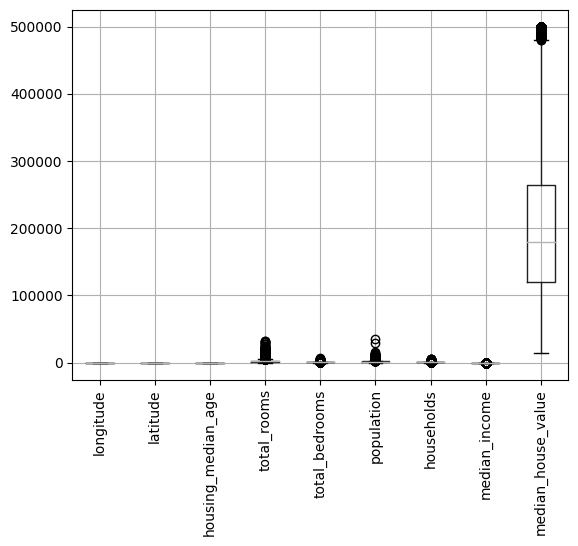

In [505]:
df.boxplot(rot=90)

In [506]:
# Mencari outliers
def find_outliers_IQR(df):
    q1=df.quantile(0.25)
    q3=df.quantile(0.75)
    IQR=q3-q1
    outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]
    return outliers

In [507]:
# Membuat fungsi untuk mengecek outliers
def find_anomalies(data):
    q1 = data.quantile(0.25)
    q3 = data.quantile(0.75)
    iqr = q3 - q1
    batas = iqr*1.5
    print(f'IQR: {iqr}')

    batas_bawah = q1 - batas
    batas_atas = q3 + batas
    print(f'Batas bawah: {batas_bawah}')
    print(f'Batas atas: {batas_atas}')        

In [508]:
df.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'ocean_proximity', 'median_house_value', 'County'],
      dtype='object')

Housing Median Age

In [509]:
# Outliers pada fitur housing_median_age
find_anomalies(df['housing_median_age'])

IQR: 19.0
Batas bawah: -10.5
Batas atas: 65.5


In [510]:
df.housing_median_age.describe()

count    14444.000000
mean        28.619150
std         12.595447
min          1.000000
25%         18.000000
50%         29.000000
75%         37.000000
max         52.000000
Name: housing_median_age, dtype: float64

In [511]:
df.housing_median_age.value_counts().head()

52.0    895
36.0    585
35.0    573
16.0    523
17.0    502
Name: housing_median_age, dtype: int64

In [512]:
df[df['housing_median_age'] >= 37]['housing_median_age'].value_counts().head()

52.0    895
37.0    375
38.0    277
42.0    270
44.0    256
Name: housing_median_age, dtype: int64

In [513]:
df.median_house_value.value_counts().head()

500001.0    678
137500.0     85
162500.0     79
187500.0     70
225000.0     69
Name: median_house_value, dtype: int64

In [514]:
outliers = find_outliers_IQR(df['housing_median_age'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))
outliers

number of outliers: 0
max outlier value: nan
min outlier value: nan


Series([], Name: housing_median_age, dtype: float64)

**Total Rooms**

In [515]:
# Outliers pada fitur total_rooms
find_anomalies(df['total_rooms'])

IQR: 1697.25
Batas bawah: -1094.875
Batas atas: 5694.125


In [516]:
outliers = find_outliers_IQR(df['total_rooms'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))
outliers

number of outliers: 899
max outlier value: 32627
min outlier value: 5699


450       6202
2140     13802
2369      6257
2391      6102
4288      6403
         ...  
14116     8259
1746      6383
5242     13714
7594      5919
2867      8363
Name: total_rooms, Length: 899, dtype: int32

In [517]:
n = len(data)
len(df[df.total_rooms >= 5694.125])
n_upper = len(np.where(df.total_rooms > 5694.125)[0])/n
n_lower = len(np.where(df.total_rooms < -1094.875)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 6.22%


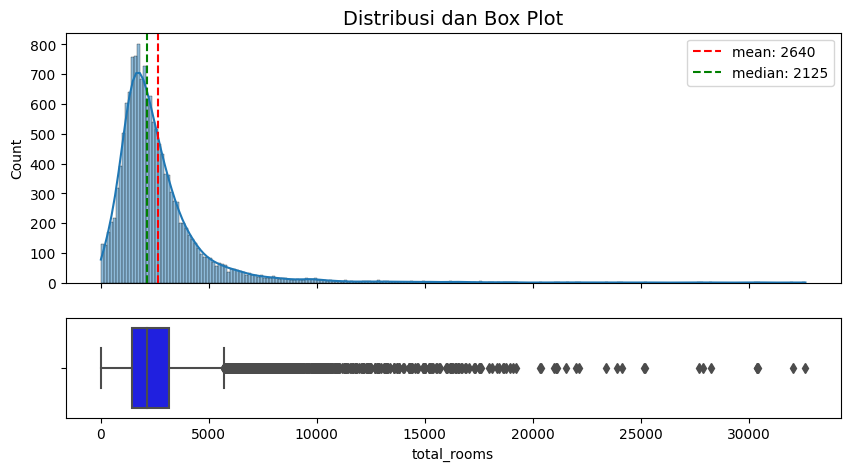

In [518]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_rooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_rooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_rooms'].mean(), color='red', label=f"mean: {round(df['total_rooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_rooms'].median(), color='green', label=f"median: {round(df['total_rooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_rooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [519]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.total_rooms)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING OUTLIER DI TOTAL ROOMS`

In [520]:
# Identifikasi data-data yang merupakan outliers
outliers = df[df['total_rooms'] > 5694.125]
outliers

# Hapus outliers dari DataFrame
df = df[df['total_rooms'] <= 5694.125]

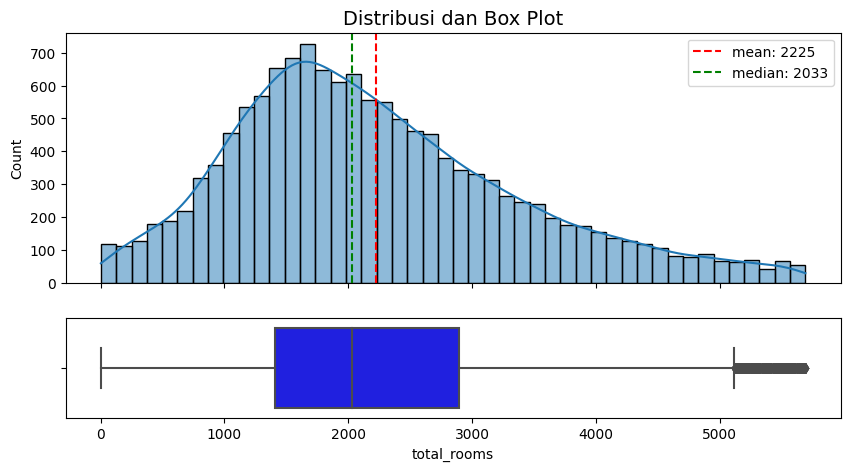

In [521]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_rooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_rooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_rooms'].mean(), color='red', label=f"mean: {round(df['total_rooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_rooms'].median(), color='green', label=f"median: {round(df['total_rooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_rooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

**Total Bedrooms**

In [522]:
# Outliers pada fitur total_rooms
find_anomalies(df['total_bedrooms'])

IQR: 309.0
Batas bawah: -176.5
Batas atas: 1059.5


In [523]:
n = len(data)
len(df[df.total_bedrooms >= 1177.5])
n_upper = len(np.where(df.total_bedrooms > 1177.5)[0])/n
n_lower = len(np.where(df.total_bedrooms < -234.5)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 1.42%


In [524]:
outliers = find_outliers_IQR(df['total_bedrooms'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 357
max outlier value: 2610
min outlier value: 1060


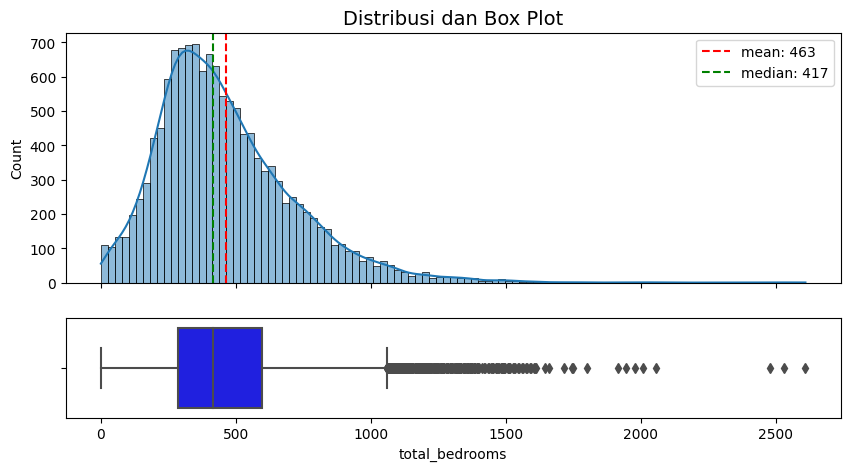

In [525]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_bedrooms'].mean(), color='red', label=f"mean: {round(df['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_bedrooms'].median(), color='green', label=f"median: {round(df['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [526]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.total_bedrooms)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING DISINI`

In [527]:
# Identifikasi data-data yang merupakan outliers
outliers = df[df['total_bedrooms'] > 1175.625]
outliers

# Hapus outliers dari DataFrame
df = df[df['total_bedrooms'] <= 1175.625]

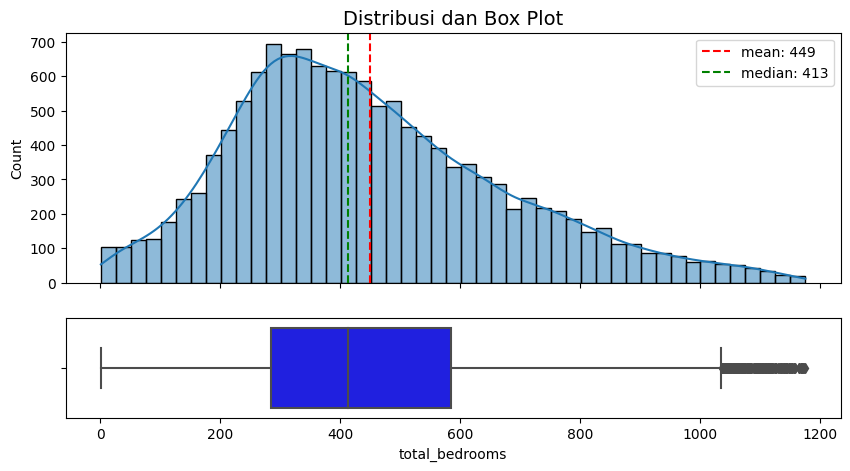

In [528]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['total_bedrooms'].mean(), color='red', label=f"mean: {round(df['total_bedrooms'].mean())}", linestyle='--')
ax1.axvline(x=df['total_bedrooms'].median(), color='green', label=f"median: {round(df['total_bedrooms'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('total_bedrooms', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

Population

In [529]:
# Outliers pada fitur total_rooms
find_anomalies(df['population'])

IQR: 803.0
Batas bawah: -443.5
Batas atas: 2768.5


In [530]:
n = len(data)
len(df[df.population >= 3134.0])
n_upper = len(np.where(df.population > 3134.0)[0])/n
n_lower = len(np.where(df.population < -626.0)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 1.19%


In [531]:
outliers = find_outliers_IQR(df['population'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 370
max outlier value: 8733
min outlier value: 2769


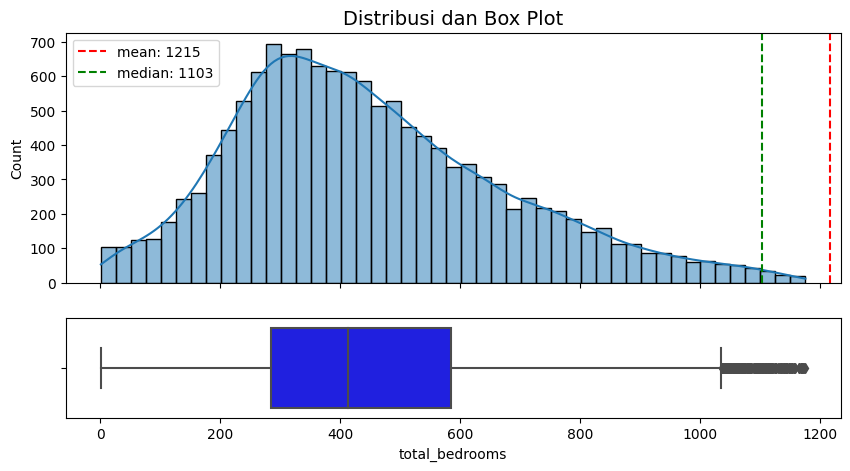

In [532]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.total_bedrooms, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.total_bedrooms, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['population'].mean(), color='red', label=f"mean: {round(df['population'].mean())}", linestyle='--')
ax1.axvline(x=df['population'].median(), color='green', label=f"median: {round(df['population'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('population', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [533]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.population)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING DISINI`

Households

In [534]:
# Outliers pada fitur total_rooms
find_anomalies(df['households'])

IQR: 276.0
Batas bawah: -144.0
Batas atas: 960.0


In [535]:
n = len(data)
len(df[df.households >= -208.5])
n_upper = len(np.where(df.households > 1091.5)[0])/n
n_lower = len(np.where(df.households < -208.5)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 0.07%


In [536]:
outliers = find_outliers_IQR(df['households'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 208
max outlier value: 1537
min outlier value: 961


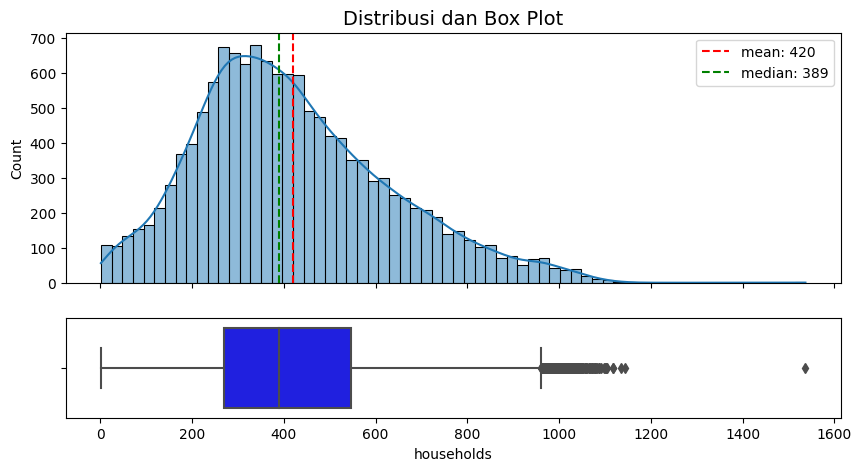

In [537]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.households, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.households, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['households'].mean(), color='red', label=f"mean: {round(df['households'].mean())}", linestyle='--')
ax1.axvline(x=df['households'].median(), color='green', label=f"median: {round(df['households'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('households', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [538]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.households)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

1.961817850054744e-44 Data tidak terdistribusi normal.


`HANDLING DISINI`

Median Income

KEMUNGKINAN TIDAK DI HANDLING KARENA MENURUT DATA PEMERINTAH US DIKETAHUI BAHWA MEDIAN INCOME PADA NEGARA BAGIAN CALIFORNIA PADA TAHUN 1990 YAITU SEBESAR 59,790. 
Sedangkan pada dataset ini diketahui max value pada median income sebesar 15.0001 dan value tersebut masih dibawah median income california
https://nces.ed.gov/programs/digest/d10/tables/dt10_025.asp

In [539]:
# Outliers pada fitur total_rooms
find_anomalies(df['median_income'])

IQR: 2.144049999999999
Batas bawah: -0.6731749999999983
Batas atas: 7.903024999999998


In [540]:
n = len(data)
len(df[df.median_income >= -208.5])
n_upper = len(np.where(df.median_income > 7.983412500000001)[0])/n
n_lower = len(np.where(df.median_income < -0.6760875000000004)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 2.92%


In [541]:
outliers = find_outliers_IQR(df['median_income'])
print('number of outliers: '+ str(len(outliers)))
print('max outlier value: '+ str(outliers.max()))
print('min outlier value: '+ str(outliers.min()))

number of outliers: 440
max outlier value: 15.0001
min outlier value: 7.9059


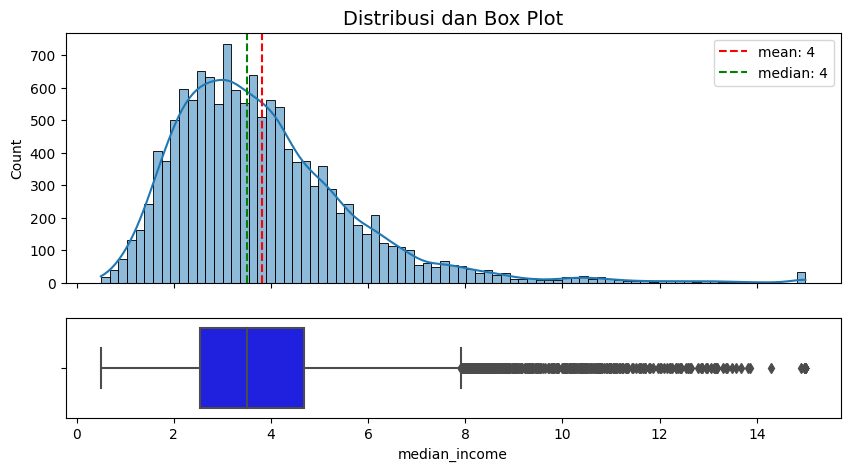

In [542]:
# Membuat figure dan axes
fig, ((ax1), (ax2)) = plt.subplots(nrows=2, ncols=1, figsize=(10,5), sharex=True, gridspec_kw={'height_ratios':[5, 2]})


# Menggabungkan displot dan boxplot menggunakan Seaborn
sns.histplot( x=df.median_income, kde=True, ax=ax1)  # Menampilkan displot
sns.boxplot(x=df.median_income, ax=ax2, color='Blue') # Menampilkan boxplot

# Menambahkan garis rata-rata dan median
ax1.axvline(x=df['median_income'].mean(), color='red', label=f"mean: {round(df['median_income'].mean())}", linestyle='--')
ax1.axvline(x=df['median_income'].median(), color='green', label=f"median: {round(df['median_income'].median())}", linestyle='--')

# Memberikan judul dan label pada sumbu
ax1.set_title('Distribusi dan Box Plot', fontsize=14)
ax1.set_xlabel('median_income', fontsize=12)

# Menampilkan legenda
ax1.legend()

# Menampilkan plot
plt.show()

In [543]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df.median_income)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


`HANDLING DISINI`

In [544]:
# Melakukan filtering pada data
# df = df[(df['median_income'] <= 7.903024999999998)]

Median House Value

In [545]:
# Outliers pada fitur total_rooms
find_anomalies(df['median_house_value'])

IQR: 143600.0
Batas bawah: -98100.0
Batas atas: 476300.0


In [546]:
n = len(data)
len(df[df.median_house_value >= 476300.0])
n_upper = len(np.where(df.median_income > 476300.0)[0])/n
n_lower = len(np.where(df.median_income < -98100.0)[0])/n
print(f'Percentage: {round((n_upper + n_lower)*100, 2)}%')

Percentage: 0.0%


In [547]:
# Melakukan filtering pada data
df = df[(df['median_house_value'] <= 452500.0)]

#### **Feature Engineering**

Encoding:

In [548]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
df['ocean_proximity'] = le.fit_transform(df['ocean_proximity'])

In [549]:
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,County
0,-119.79,36.73,52.0,112,28,193,40,1.9750,1,47500.0,Fresno County
4,-119.81,36.73,50.0,772,194,606,167,2.2206,1,59200.0,Fresno County
25,-120.38,36.76,12.0,932,244,1043,243,1.4038,1,54300.0,Fresno County
32,-119.83,36.80,24.0,3756,681,1586,739,3.8571,1,90100.0,Fresno County
58,-119.81,36.71,25.0,1026,221,789,183,1.5625,1,52800.0,Fresno County
...,...,...,...,...,...,...,...,...,...,...,...
5365,-120.24,39.67,40.0,690,129,305,110,2.3625,1,62500.0,Sierra County
9082,-120.48,39.66,32.0,1516,289,304,131,1.8839,1,71000.0,Sierra County
9199,-120.23,39.56,14.0,1781,346,734,287,2.4600,1,93000.0,Sierra County
13753,-120.92,39.56,48.0,1276,292,358,145,1.8750,1,66600.0,Sierra County


Feature Creation:

Avg total rooms : berisikan informasi terkait rata rata total ruangan di dalam satu rumah 

In [550]:
df['avg_rooms_per_house'] = round(df['total_rooms'] / df['households'])

Avg bedrooms per house : Informasi terkait rata rata kamar tidur di dalam satu rumah

In [551]:
df['avg_bedrooms_per_house'] = round(df['total_bedrooms'] / df['households'])

Avg person per house : Informasi terkait rata rata jumlah orang yang dapat tinggal di dalam satu rumah

In [552]:
df['avg_persons_per_house'] = round(df['population'] / df['households'])

Distance antar city: Informasi terkait seberapa jauh rumah terhadap pusat kota atau kota kota besar yang berada di California.

Alasan:\
General --> karena salah satu faktor untuk menentukan harga rumah dapat dilihat dari seberapa jauh rumah tersebut terhadap pusat kotak atau kota kota besar yang menjadi pusat bisnis di suatu wilayah.

Spesifik (per city)

In [553]:
def haversine(lat1, lon1, lat2, lon2):
    # Mengubah derajat menjadi radian
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    
    # Rumus haversine
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a)) 
    r = 6371 # Radius bumi dalam kilometer
    return c * r

# Koordinat Los Angeles dan San Francisco
lat_LA, lon_LA = 34.05, -118.25
lat_SF, lon_SF = 37.77, -122.42
lat_Sac, lon_Sac = 38.58, -121.49
lat_SJ, lon_SJ = 37.34, -121.89
lat_SD, lon_SD = 32.72, -117.16

# Menghitung jarak ke Los Angeles dan San Francisco
df['distance_to_LA'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_LA, lon_LA), axis=1)
df['distance_to_SF'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_SF, lon_SF), axis=1)
df['distance_to_Sac'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_Sac, lon_Sac), axis=1)
df['distance_to_SJ'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_SJ, lon_SJ), axis=1)
df['distance_to_SD'] = df.apply(lambda row: haversine(row['latitude'], row['longitude'], lat_SD, lon_SD), axis=1)


Feature Selection:

In [554]:
selected_columns1 = ['median_house_value',  'distance_to_LA', 'distance_to_SF','distance_to_Sac', 'distance_to_SJ', 'distance_to_SD']
correlation_matrix1 = df[selected_columns1].corr()
correlation_matrix1


,median_house_value,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD
median_house_value,1.000000,-0.141155,-0.026801,0.067001,-0.038671,-0.106438
distance_to_LA,-0.141155,1.000000,-0.836671,-0.870220,-0.778255,0.951320
distance_to_SF,-0.026801,-0.836671,1.000000,0.978323,0.989646,-0.918849
distance_to_Sac,0.067001,-0.870220,0.978323,1.000000,0.961482,-0.948101
distance_to_SJ,-0.038671,-0.778255,0.989646,0.961482,1.000000,-0.875154
distance_to_SD,-0.106438,0.951320,-0.918849,-0.948101,-0.875154,1.000000


fitur yang sekitarnya memilki pengaruh terhadap target:
- housing median age
- avg rooms per house
- avg bedrooms per house 
- avg_persons_per_house
- population
- households (penting karena untuk tau kelangkaan rumah diwilayah tersebut, karena jika population tinggi tetapi jumlah rumah sedikit maka dapat dikatakan bahwa harga rumah cenderung lebih tinggi karena permintaan tinggi dan pasokan terbatas.)
- ocean_proximity
- distance_to_LA	
- distance_to_SF	
- distance_to_Sac	
- distance_to_SJ	
- distance_to_SD


Target:
- median_house_value

In [555]:
df_model = df[['longitude', 'latitude', 'housing_median_age', 'avg_rooms_per_house', 'avg_bedrooms_per_house','avg_persons_per_house','population', 'households', 'median_income',
       'ocean_proximity','distance_to_LA', 'distance_to_SF','distance_to_Sac', 'distance_to_SJ', 'distance_to_SD', 'median_house_value']]

In [556]:
df_model

,longitude,latitude,housing_median_age,avg_rooms_per_house,avg_bedrooms_per_house,avg_persons_per_house,population,households,median_income,ocean_proximity,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD,median_house_value
0,-119.79,36.73,52.0,3.0,1.0,5.0,193,40,1.9750,1,329.065723,259.912510,254.377641,198.354556,506.488043,47500.0
4,-119.81,36.73,50.0,5.0,1.0,4.0,606,167,2.2206,1,329.838549,258.328567,253.346102,196.687370,507.357029,59200.0
25,-120.38,36.76,12.0,4.0,1.0,4.0,1043,243,1.4038,1,357.844957,212.601407,224.717533,148.715185,536.915541,54300.0
32,-119.83,36.80,24.0,5.0,1.0,2.0,1586,739,3.8571,1,337.624967,253.241125,245.978009,192.373712,515.022512,90100.0
58,-119.81,36.71,25.0,6.0,1.0,4.0,789,183,1.5625,1,327.838461,259.358748,255.166474,197.487914,505.418290,52800.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5365,-120.24,39.67,40.0,6.0,1.0,3.0,305,110,2.3625,1,649.458010,283.536597,162.220617,296.192528,820.588494,62500.0
9082,-120.48,39.66,32.0,12.0,2.0,2.0,304,131,1.8839,1,654.531321,269.237485,148.366872,285.655342,827.035100,71000.0
9199,-120.23,39.56,14.0,6.0,1.0,3.0,734,287,2.4600,1,637.488715,275.244923,153.966143,286.050392,808.845455,93000.0
13753,-120.92,39.56,48.0,9.0,2.0,2.0,358,145,1.8750,1,657.091505,237.850492,119.565420,260.899981,831.930192,66600.0


Bagi dataset menjadi train dan test dengan komposisi 70:30

In [557]:
from sklearn.model_selection import train_test_split

X = df_model.drop(columns='median_house_value')
y = df_model['median_house_value']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((8786, 15), (3766, 15))

In [558]:
df_model

,longitude,latitude,housing_median_age,avg_rooms_per_house,avg_bedrooms_per_house,avg_persons_per_house,population,households,median_income,ocean_proximity,distance_to_LA,distance_to_SF,distance_to_Sac,distance_to_SJ,distance_to_SD,median_house_value
0,-119.79,36.73,52.0,3.0,1.0,5.0,193,40,1.9750,1,329.065723,259.912510,254.377641,198.354556,506.488043,47500.0
4,-119.81,36.73,50.0,5.0,1.0,4.0,606,167,2.2206,1,329.838549,258.328567,253.346102,196.687370,507.357029,59200.0
25,-120.38,36.76,12.0,4.0,1.0,4.0,1043,243,1.4038,1,357.844957,212.601407,224.717533,148.715185,536.915541,54300.0
32,-119.83,36.80,24.0,5.0,1.0,2.0,1586,739,3.8571,1,337.624967,253.241125,245.978009,192.373712,515.022512,90100.0
58,-119.81,36.71,25.0,6.0,1.0,4.0,789,183,1.5625,1,327.838461,259.358748,255.166474,197.487914,505.418290,52800.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5365,-120.24,39.67,40.0,6.0,1.0,3.0,305,110,2.3625,1,649.458010,283.536597,162.220617,296.192528,820.588494,62500.0
9082,-120.48,39.66,32.0,12.0,2.0,2.0,304,131,1.8839,1,654.531321,269.237485,148.366872,285.655342,827.035100,71000.0
9199,-120.23,39.56,14.0,6.0,1.0,3.0,734,287,2.4600,1,637.488715,275.244923,153.966143,286.050392,808.845455,93000.0
13753,-120.92,39.56,48.0,9.0,2.0,2.0,358,145,1.8750,1,657.091505,237.850492,119.565420,260.899981,831.930192,66600.0


### `Modeling`

**Model Experiment**

Bandingkan model regresi atau klasifikasi untuk mendapatkan benchmark model:

In [559]:
# Import library untuk modeling

from sklearn.model_selection import train_test_split, cross_val_score, RandomizedSearchCV, GridSearchCV, KFold
import category_encoders as ce
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Algoritma
from sklearn.compose import TransformedTargetRegressor
# Tidak Robust Terhadap Outliers 
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor

# Robust terhadap Outliers
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost.sklearn import XGBRegressor




from sklearn.preprocessing import StandardScaler

from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, mean_absolute_percentage_error

In [560]:
# Define algoritma yang digunakan
lr = LinearRegression()
knn = KNeighborsRegressor()
dt = DecisionTreeRegressor(random_state=1)
rf = RandomForestRegressor(random_state=1)
xgb = XGBRegressor(random_state=1)

# Pemodelan dilakukan dalam skala logaritmik, namun kemudian di-inverse kembali untuk interpretasi
log_lr = TransformedTargetRegressor(lr, func=np.log, inverse_func=np.exp)
log_knn = TransformedTargetRegressor(knn, func=np.log, inverse_func=np.exp)
log_dt = TransformedTargetRegressor(dt, func=np.log, inverse_func=np.exp)
log_rf = TransformedTargetRegressor(rf, func=np.log, inverse_func=np.exp)
log_xgb = TransformedTargetRegressor(xgb, func=np.log, inverse_func=np.exp)

# Scaling data
scaler = StandardScaler()

# Create the transformer object
transformer = StandardScaler()


# Kandidat algoritma
models = [log_lr, log_knn, log_dt, log_rf, log_xgb]

score_rmse = []
nilai_mean_rmse = []
nilai_std_rmse = []

score_mae = []
nilai_mean_mae = []
nilai_std_mae = []

score_mape = []
nilai_mean_mape = []
nilai_std_mape = []

# Mencari algoritma terbaik berdasarkan tiap metrics
for i in models:
    
    crossval = KFold(n_splits=5, shuffle=True, random_state=1)

    estimator = Pipeline([
        ('preprocessing', transformer),
        ('scaler', scaler),
        ('model', i)
    ])

    # RMSE
    model_cv_rmse = cross_val_score(
        estimator, 
        X_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_root_mean_squared_error', 
        error_score='raise'
        )

    print(model_cv_rmse, i)

    score_rmse.append(model_cv_rmse)
    nilai_mean_rmse.append(model_cv_rmse.mean())
    nilai_std_rmse.append(model_cv_rmse.std())

    # MAE
    model_cv_mae = cross_val_score(
        estimator, 
        X_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_mean_absolute_error', 
        error_score='raise'
        )

    print(model_cv_mae, i)

    score_mae.append(model_cv_mae)
    nilai_mean_mae.append(model_cv_mae.mean())
    nilai_std_mae.append(model_cv_mae.std())

    # MAPE
    model_cv_mape = cross_val_score(
        estimator, 
        X_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_mean_absolute_percentage_error', 
        error_score='raise'
        )

    print(model_cv_mape, i)

    score_mape.append(model_cv_mape)
    nilai_mean_mape.append(model_cv_mape.mean())
    nilai_std_mape.append(model_cv_mape.std())

[-59568.62029098 -63885.35469067 -57656.17782685 -58662.16589964
 -63125.41061111] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-41801.51638248 -42607.69466756 -41389.95266302 -41841.04517202
 -41445.86285089] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-0.25661964 -0.24714905 -0.24469157 -0.24292041 -0.25858823] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())


[-55569.856955   -55921.81618422 -52457.70602824 -56250.11073442
 -53374.16205708] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())
[-37501.48995468 -38725.76336605 -37318.99507144 -38362.15206814
 -37751.70351048] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())
[-0.21314325 -0.21651417 -0.21199799 -0.20869769 -0.22795289] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())
[-62475.81511595 -62447.76054738 -59946.46050844 -60522.33986997
 -59897.03418307] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=DecisionTreeRegressor(random_state=1))
[-40047.78156997 -40457.76949345 -40157.93966989 -40342.57370518
 -39769.21001707] TransformedTargetRegressor(func=<ufunc 'log'>, inv

In [561]:
# Evaluasi hasil dari 5 kandidat algoritma yang digunakan
pd.DataFrame({
    'Model': ['Linear Regression', 'KNN Regressor', 'DecisionTree Regressor', 'RandomForest Regressor', 'XGBoost Regressor'],
    'Mean_RMSE': nilai_mean_rmse,
    'Std_RMSE': nilai_std_rmse,
    'Mean_MAE': nilai_mean_mae,
    'Std_MAE': nilai_std_mae,
    'Mean_MAPE': nilai_mean_mape,
    'Std_MAPE': nilai_std_mape
})

,Model,Mean_RMSE,Std_RMSE,Mean_MAE,Std_MAE,Mean_MAPE,Std_MAPE
0,Linear Regression,-60579.545864,2476.053167,-41817.214347,435.000679,-0.249994,0.006388
1,KNN Regressor,-54714.730392,1512.413487,-37932.020794,530.794093,-0.215661,0.006634
2,DecisionTree Regressor,-61057.882045,1167.212702,-40155.054891,239.662926,-0.235433,0.006794
3,RandomForest Regressor,-44097.268892,1832.466250,-28869.151543,693.229896,-0.165601,0.005096
4,XGBoost Regressor,-42680.747113,1592.138729,-28167.019426,592.871106,-0.162400,0.004066


In [562]:
# Benchmark 2 model terbaik
models = {
    'XGB': XGBRegressor(random_state=1),
    'RandomForest': RandomForestRegressor(random_state=1)
}

score_rmse = []
score_mae = []
score_mape = []

# Prediksi pada test set
for i in models:

    model = Pipeline([
        ('preprocessing', transformer),
        ('scaler', scaler),
        ('model', models[i])
        ])

    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    score_rmse.append(np.sqrt(mean_squared_error(y_test, y_pred)))
    score_mae.append(mean_absolute_error(y_test, y_pred))
    score_mape.append(mean_absolute_percentage_error(y_test, y_pred))

score_before_tuning = pd.DataFrame({'RMSE': score_rmse, 'MAE': score_mae, 'MAPE': score_mape}, index=models.keys())
score_before_tuning

,RMSE,MAE,MAPE
XGB,40870.685067,27912.832102,0.167227
RandomForest,41976.119687,28403.114108,0.169342


In [563]:
# Kedalaman pohon
max_depth = list(np.arange(1, 11))

# Learning rate
learning_rate = list(np.arange(1, 100)/100)

# Jumlah pohon
n_estimators = list(np.arange(100, 201))

# Jumlah baris tiap pohon (% dari total baris train set)
subsample = list(np.arange(2, 10)/10)

# Gamma (min_impurity_decrease)
gamma = list(np.arange(1, 11)) # Semakin besar nilainya, semakin konservatif/simpel modelnya

# Jumlah feature yang digunakan untuk tiap pohon (% dari total kolom train set)
colsample_bytree = list(np.arange(1, 10)/10)

# Alpha (regularization)
reg_alpha = list(np.logspace(-3, 1, 10)) # Semakin besar nilainya, semakin konservatif/simpel modelnya


# Hyperparam space XGboost
hyperparam_space_xgb = {
    'model__max_depth': max_depth, 
    'model__learning_rate': learning_rate,
    'model__n_estimators': n_estimators,
    'model__subsample': subsample,
    'model__gamma': gamma,
    'model__colsample_bytree': colsample_bytree,
    'model__reg_alpha': reg_alpha
}

In [564]:
# Benchmark model dengan hyperparameter tuning
xgb = XGBRegressor(random_state=1, verbosity=0)

# Membuat algorithm chains
estimator_xgb = Pipeline([
        ('preprocessing', transformer),
        ('scaler', scaler),
        ('model', xgb)
        ])

crossval = KFold(n_splits=5, shuffle=True, random_state=1)

# Hyperparameter tuning
random_xgb = RandomizedSearchCV(
    estimator_xgb, 
    param_distributions = hyperparam_space_xgb,
    n_iter = 50,
    cv = crossval, 
    scoring = ['neg_root_mean_squared_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error'], 
    n_jobs = -1,
    refit = 'neg_root_mean_squared_error', # Hanya bisa memilih salah stau metric untuk optimisasi
    random_state = 1  
)

In [565]:
# Fitting data training untuk mencari parameter terbaik
random_xgb.fit(X_train, y_train)

RandomizedSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
                   estimator=Pipeline(steps=[('preprocessing',
                                              StandardScaler()),
                                             ('scaler', StandardScaler()),
                                             ('model',
                                              XGBRegressor(base_score=None,
                                                           booster=None,
                                                           callbacks=None,
                                                           colsample_bylevel=None,
                                                           colsample_bynode=None,
                                                           colsample_bytree=None,
                                                           early_stopping_rounds=None,
                                                           enable_categorical=False,
                                                           eval_met...
                                                             0.007742636826811269,
                                                             0.021544346900318832,
                                                             0.05994842503189409,
                                                             0.1668100537200059,
                                                             0.46415888336127775,
                                                             1.2915496650148828,
                                                             3.593813663804626,
                                                             10.0],
                                        'model__subsample': [0.2, 0.3, 0.4, 0.5,
                                                             0.6, 0.7, 0.8,
                                                             0.9]},
                   random_state=1, refit='neg_root_mean_squared_error',
                   scoring=['neg_root_mean_squared_error',
                            'neg_mean_absolute_error',
                            'neg_mean_absolute_percentage_error'])

In [566]:
# Melihat hasil tuning dalam bentuk dataframe. Diurutkan berdasarkan RMSE, MAE & MAPE
pd.DataFrame(random_xgb.cv_results_).sort_values(by=['rank_test_neg_root_mean_squared_error', 'rank_test_neg_mean_absolute_error', 'rank_test_neg_mean_absolute_percentage_error']).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_model__subsample,param_model__reg_alpha,param_model__n_estimators,param_model__max_depth,param_model__learning_rate,param_model__gamma,param_model__colsample_bytree,params,split0_test_neg_root_mean_squared_error,split1_test_neg_root_mean_squared_error,split2_test_neg_root_mean_squared_error,split3_test_neg_root_mean_squared_error,split4_test_neg_root_mean_squared_error,mean_test_neg_root_mean_squared_error,std_test_neg_root_mean_squared_error,rank_test_neg_root_mean_squared_error,split0_test_neg_mean_absolute_error,split1_test_neg_mean_absolute_error,split2_test_neg_mean_absolute_error,split3_test_neg_mean_absolute_error,split4_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_error,std_test_neg_mean_absolute_error,rank_test_neg_mean_absolute_error,split0_test_neg_mean_absolute_percentage_error,split1_test_neg_mean_absolute_percentage_error,split2_test_neg_mean_absolute_percentage_error,split3_test_neg_mean_absolute_percentage_error,split4_test_neg_mean_absolute_percentage_error,mean_test_neg_mean_absolute_percentage_error,std_test_neg_mean_absolute_percentage_error,rank_test_neg_mean_absolute_percentage_error
3,2.215434,0.175805,0.031239,0.001978,0.5,0.021544,166,8,0.1,9,0.3,"{'model__subsample': 0.5, 'model__reg_alpha': ...",-42801.735577,-41593.785648,-38730.554212,-42298.752728,-38925.157540,-40869.997141,1712.100630,1,-27740.030397,-27975.180128,-27124.013175,-28176.975542,-26703.600690,-27543.959986,549.119692,1,-0.172172,-0.169643,-0.162656,-0.162865,-0.177350,-0.168937,0.005622,2
7,4.866277,1.755929,0.025490,0.003231,0.9,0.059948,119,8,0.05,5,0.8,"{'model__subsample': 0.9, 'model__reg_alpha': ...",-43464.886784,-41744.163061,-39205.379373,-42888.819143,-40260.048979,-41512.659468,1590.671263,2,-27939.321650,-27901.140207,-27585.644614,-28599.681182,-27409.675790,-27887.092688,407.309561,2,-0.169124,-0.166561,-0.163018,-0.163728,-0.179443,-0.168375,0.005944,1
13,2.206357,0.062867,0.048754,0.009941,0.6,0.059948,171,9,0.18,4,0.2,"{'model__subsample': 0.6, 'model__reg_alpha': ...",-43966.390255,-43274.956607,-40882.989212,-43907.596799,-41348.614166,-42676.109408,1305.184085,3,-29503.637756,-29316.333496,-29215.179423,-29335.667755,-28857.389712,-29245.641629,215.096045,3,-0.187536,-0.179927,-0.177352,-0.173450,-0.191327,-0.181918,0.006582,6
23,1.394436,0.562894,0.039830,0.040040,0.9,3.593814,153,4,0.33,9,0.3,"{'model__subsample': 0.9, 'model__reg_alpha': ...",-44558.650700,-43674.492143,-40799.557608,-43531.184624,-41360.877745,-42784.952564,1446.646484,4,-29533.964106,-29809.194831,-29176.818583,-29376.282197,-28417.840680,-29262.820079,470.383790,4,-0.185123,-0.179580,-0.175012,-0.171991,-0.192928,-0.180927,0.007460,5
22,1.149349,0.045177,0.019953,0.003524,0.7,0.002783,155,4,0.25,8,0.3,"{'model__subsample': 0.7, 'model__reg_alpha': ...",-43868.604659,-44084.088326,-41823.186162,-44082.959948,-42002.677175,-43172.303254,1032.823835,5,-29014.353882,-30239.156556,-29561.704521,-29518.367990,-28996.928547,-29466.102299,454.683409,5,-0.181913,-0.181211,-0.177569,-0.169932,-0.190123,-0.180150,0.006554,3


In [567]:
# Cek skor dan params terbaik
print('XGBoost')
print('Best_score:', random_xgb.best_score_)
print('Best_params:', random_xgb.best_params_)

XGBoost
Best_score: -40869.99714116853
Best_params: {'model__subsample': 0.5, 'model__reg_alpha': 0.021544346900318832, 'model__n_estimators': 166, 'model__max_depth': 8, 'model__learning_rate': 0.1, 'model__gamma': 9, 'model__colsample_bytree': 0.3}


In [568]:
# Model XGBoost
model = {'XGB': XGBRegressor(random_state=1)}

# Define model terhadap estimator terbaik
xgb_tuning = random_xgb.best_estimator_

# Fitting model
xgb_tuning.fit(X_train, y_train)

# Predict test set
y_pred_xgb_tuning = xgb_tuning.predict(X_test)

# Simpan nilai metrics RMSE, MAE & MAPE setelah tuning
rmse_xgb_tuning = np.sqrt(mean_squared_error(y_test, y_pred_xgb_tuning))
mae_xgb_tuning = mean_absolute_error(y_test, y_pred_xgb_tuning)
mape_xgb_tuning = mean_absolute_percentage_error(y_test, y_pred_xgb_tuning)

score_after_tuning = pd.DataFrame({'RMSE': rmse_xgb_tuning, 'MAE': mae_xgb_tuning, 'MAPE': mape_xgb_tuning}, index=model.keys())
score_after_tuning

,RMSE,MAE,MAPE
XGB,39166.540744,26835.428956,0.16107


Performan Comparison

In [569]:
# Sebelum hyperparameter tuning
pd.DataFrame(score_before_tuning.loc['XGB']).T

,RMSE,MAE,MAPE
XGB,40870.685067,27912.832102,0.167227


In [570]:
# Setelah hyperparameter tuning
score_after_tuning

,RMSE,MAE,MAPE
XGB,39166.540744,26835.428956,0.16107


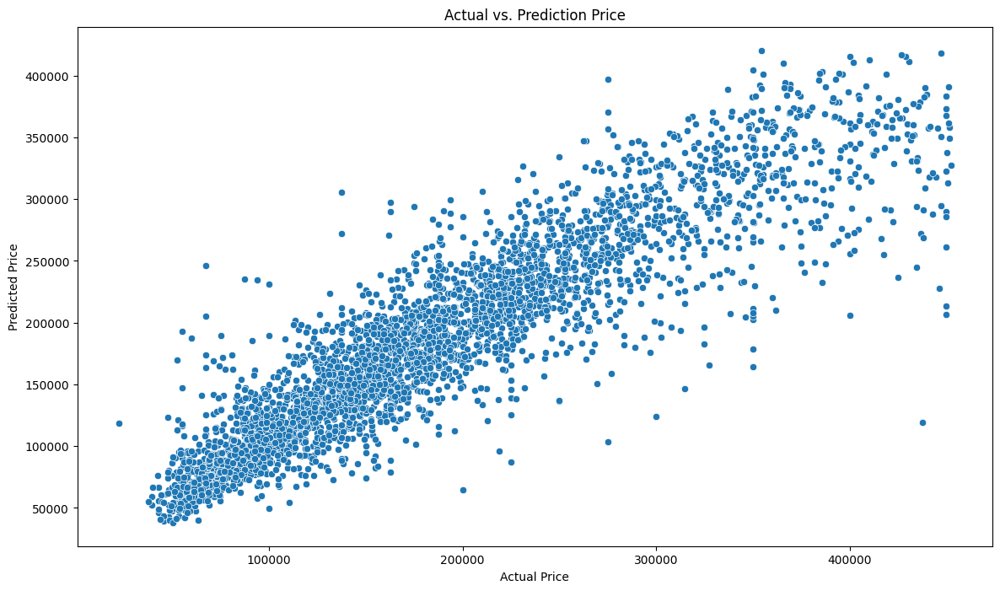

In [571]:
plt.figure(figsize=(14, 8))
plot = sns.scatterplot(x=y_test, y=y_pred_xgb_tuning).set(title='Actual vs. Prediction Price', 
                                               xlabel='Actual Price', 
                                               ylabel='Predicted Price')

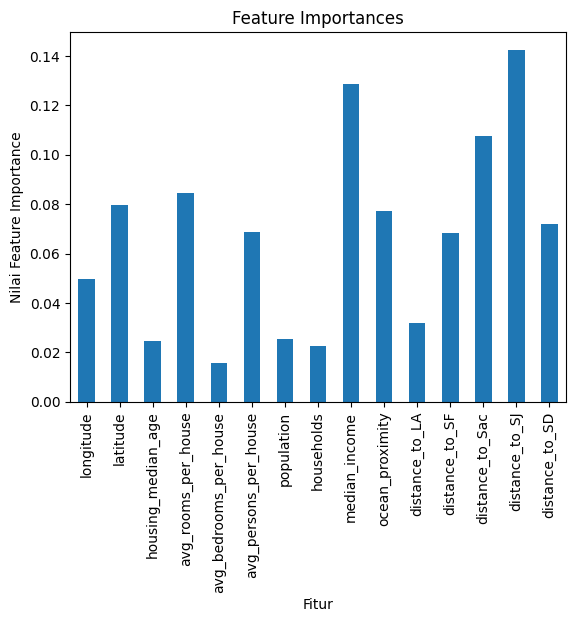

In [572]:
# Mendapatkan feature importances dari model XGBoost
feature_imp = pd.Series(xgb_tuning['model'].feature_importances_)

# Dapatkan daftar nama fitur setelah transformasi dari objek transformer
transformed_feature_names = transformer.get_feature_names_out(input_features=X_train.columns)

# Mengaitkan daftar nama fitur dengan feature_importances_
feature_imp.index = transformed_feature_names

# Menampilkan feature importances dalam bentuk bar plot
feature_imp.plot(kind='bar', title='Feature Importances')
plt.xlabel('Fitur')
plt.ylabel('Nilai Feature Importance')
plt.show()


In [573]:
# Residual = y_actual - y_prediksi
residual = y_test-y_pred_xgb_tuning

df_residual = pd.DataFrame({
    'y_pred': y_pred_xgb_tuning,
    'residual': residual 
})

df_residual.head()

,y_pred,residual
3668,173646.796875,46153.203125
6214,264478.375000,-15778.375000
13087,106521.867188,-26121.867188
358,240110.359375,-25410.359375
12713,223106.406250,-13306.406250


<Axes: xlabel='median_house_value', ylabel='Count'>

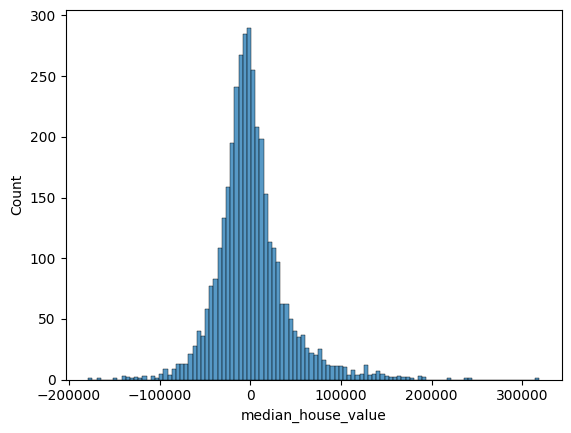

In [574]:
# Check apakah residual memiliki outlier

sns.histplot(data=df_residual,x=residual)

residual akan berpusat di titik median, yang diharapkan residual bernilai 0. y pred > y actual

In [575]:
from scipy.stats import shapiro

# Shapiro-Wilk
statistic, p_value = shapiro(df_residual)

# Cek apakah data terdistribusi normal dengan tingkat signifikansi 0.05
if p_value > 0.05:
    print(p_value,"Data terdistribusi normal.")
else:
    print(p_value,"Data tidak terdistribusi normal.")

0.0 Data tidak terdistribusi normal.


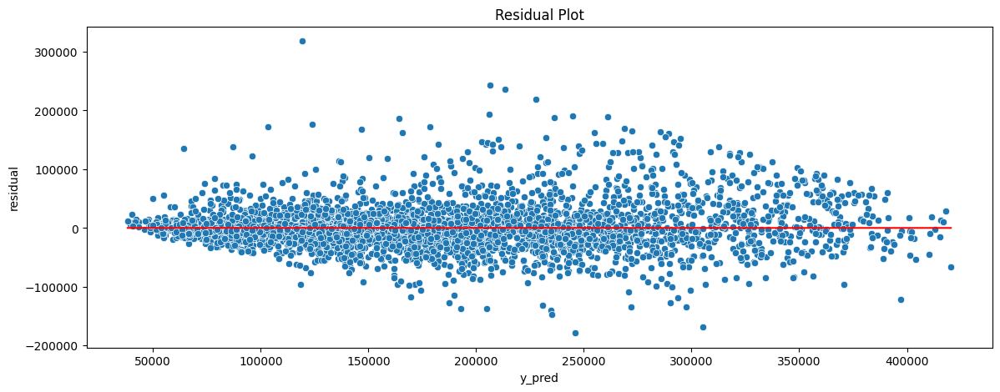

In [576]:
# Residual Plot

plt.figure(figsize=(14,5))
sns.scatterplot(data=df_residual, x='y_pred', y='residual')
sns.lineplot(data=df_residual, x='y_pred', y=0, color='red')
plt.title('Residual Plot')
plt.show()

In [577]:
print(f'Jumlah baris dan kolom: {df_model.shape}')

Jumlah baris dan kolom: (12552, 16)


Lakukan optimasi model benchmark:

Validasi silang 10-fold untuk mendapatkan rentang kinerja model:

**Model Intepretation**

* .....
* .....
* .....

**Model Limitation**

* .....
* .....
* .....


### `Conclusion`

Beberapa hal yang dapat disimpulkan yaitu:

* ....
* ....
* ....

### `Recommendations`

Hal yang dapat dilakukan untuk mengembangkan model agar lebih baik lagi, seperti:

* ....
* ....
* ....